In [165]:
import numpy as np
import pandas as pd
import seaborn as sns
import lightgbm as lgb
import matplotlib.pyplot as plt
import itertools
import gc

from sklearn import metrics
from datetime import datetime
from pandas_profiling import ProfileReport
from pandas.core.common import SettingWithCopyWarning
from tqdm import tqdm

from sklearn.svm import SVR
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import RidgeCV
from sklearn.preprocessing import Normalizer, MinMaxScaler
from sklearn.ensemble import RandomForestRegressor, StackingRegressor
from sklearn.model_selection import cross_val_score, GroupKFold
from sklearn.metrics import mean_squared_error
from sklearn.mixture import GaussianMixture, BayesianGaussianMixture
from sklearn.cluster import *

# off warnings
import warnings
warnings.simplefilter(action="ignore", category=SettingWithCopyWarning)
warnings.simplefilter(action="ignore", category=FutureWarning)

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', 200)

RANDOM_STATE = 42
PROJ_PATH = "/home/kirill/projects/personal_projects/xeek-Steam-Optimization/"

train_data_path = PROJ_PATH + "data/raw/train.csv"
test_data_path = PROJ_PATH + "data/raw/test_data.csv"

# Navigation

# EDA

## Functions for EDA

In [59]:
# delete features(Data Update (10/5/21))
def remove_bad_variables(df):
    """Checks dataframe for variables and drops 
    them if present.
    
    Parameters
    ----------
    
    df : DataFrame
        Source DataFrame
    """
    
    col_names = list(df.columns)
    for i in ['RMNG_OIL_H', 'GAS_H']:
        if i in col_names:
            df = df.drop(i, axis=1)
    return df


# plot 'timestamp feature' lineplot for specify facility id
def plot_cumulative_feature(df, pw_id, feature):
    """Plot cumulative feature.
    
    Parameters
    ----------
    
    df : DataFrame
        Source DataFrame
    pw_id : int
        Facility id
    feature : str
        Feature for plot
    """
    
    df_pw = df_train[df_train['CMPL_FAC_ID'] == pw_id]
    df_pw['timestamp'] = pd.to_datetime(df_pw['SURV_DTE'])
    df_pw = df_pw.sort_values(by='timestamp')
    df_pw.reset_index(drop=True, inplace=True)
    
    sns.lineplot(y=df_pw[feature], x=range(len(df_pw)))
    plt.show()

    
# convert datetime string to datetime object
def get_surv_dte(s):
    """Convert string date(format month/day/year of year-month-day) in datetime object.
    
    Parameters
    ----------
    
    s : str
        Date string
    """
    
    if '/' in s:
        return datetime.strptime(s, '%m/%d/%Y')
    else:
        return datetime.strptime(s, '%Y-%m-%d')
    

# return dataframe with normalized feature by specify group
def get_norm_feature_by_group(df, group=['CMPL_FAC_ID'], feature='TOTAL_INJ', res_feature_name='total_inj_fac', fillna=0):
    """Return dataframe with normalized feature 
    by maximum of specify group.
    
    Parameters
    ----------
    
    df : DataFrame
        Input dataframe, must contain group and feature for normalization
    group : List
        Need for determine the groups
    feature : str
        The attribute for which normalization is carried out
    res_feature_name : str
        Name of result normalized feature
    fillna : int
    """

    index, values = [], []
    for mini_df in df.groupby(by=group):
        mini_df = mini_df[1].reset_index()
        
        # find maximum of one group
        max_f = mini_df[feature].max()
        
        mini_df[feature] = mini_df[feature] / max_f
        mini_df[feature] = mini_df[feature].replace(np.nan, fillna)
            
        # save index of initial df and new value 
        index += mini_df['index'].to_list()
        values += mini_df[feature].to_list()
        
    # add values by index in initial df
    df.loc[index, res_feature_name] = values  
    df[res_feature_name] = df[res_feature_name].astype(float)
    return df


# get number of measurement in context of facility+sand by date
def get_seq_num(df, res_feature_name='seq_num', normalize=True):
    """Return dataframe with number of measurement sorted by date.
    
    Parameters
    ----------
    
    df : DataFrame
        Must contain date, facility id and sand features(SURV_DTE, CMPL_FAC_ID and SAND)
    res_feature_name : str   
        Name of result normalized feature
    normalize : bool
        Normalize feature by maximum number of sequence or not
    """
    
    df = df.copy()
    df = df.sort_values(by='SURV_DTE')
    
    group = df.groupby(by=['CMPL_FAC_ID', 'SAND'])
    group_camcount =  group.cumcount()
    df[res_feature_name] = df.index.map(group_camcount)
    
    if normalize:
        sand_count_mapping = dict()
        for i in df['CMPL_FAC_ID'].unique():
            _df = df[df['CMPL_FAC_ID'] == i]
            sand_count_mapping[i] = _df.groupby(by='SAND')[res_feature_name].max().to_dict()
        df[res_feature_name] = df[res_feature_name] / df.apply(lambda x: sand_count_mapping[x['CMPL_FAC_ID']][x['SAND']], axis=1)
        df[res_feature_name] = df[res_feature_name].fillna(0)
        
    df[res_feature_name] = df[res_feature_name].astype(float)
    df = df.sort_index() 
    return df


# get number of steam injectors
def get_sinjectors_num(r):
    """Return number of steam injectors by measurement(row).
    
    Parameters
    ----------
    
    r : Series
        Row of table of measurements
    """
    
    st_v, st_d = [], []
    st_v.append(r['SGMT_CUM_STM_INJ_1']); st_d.append(r['FT_DIST_PAT_1'])
    st_v.append(r['SGMT_CUM_STM_INJ_2']); st_d.append(r['FT_DIST_PAT_2'])
    st_v.append(r['SGMT_CUM_STM_INJ_3']); st_d.append(r['FT_DIST_PAT_3'])
    
    inj_num = 0
    for i in range(3):
        # all features of one steam inj is not nan
        if not (pd.isna(st_v[i]) or pd.isna(st_d[i])):
            inj_num += 1
            
    return inj_num


# get time of life for measurements of specify group
def get_life_time(df, group=['CMPL_FAC_ID'], res_feature_name='fcl_life_time', normalize=True):
    """Return life time in days for each measurement in context of group, 
    for example given meas. with SURV_DTE's: 1/1/1990, 1/1/1994, 1/1/1995,
    preprocessed: 0, 1460, 1825 or with normalize=True: 0, 0.8, 1
    
    Parameters
    ----------
    
    df : DataFrame
        Initial dataframe, must contain facility id and date features(CMPL_FAC_ID, SURV_DTE)
    group : List
        List of feature for determine of group
    res_feature_name : str
        Name of result feature
    normalize : bool
        Normalize life time by maximum in lf. in group or not
    """
    
    df = df.copy()
    df[res_feature_name] = df['SURV_DTE']
    
    index, values = [], []
    for mini_df in df.groupby(by=group):
        mini_df = mini_df[1].reset_index()
        min_lifetime = mini_df[res_feature_name].min()
        mini_df[res_feature_name] = mini_df[res_feature_name].map(lambda x: (x - min_lifetime).days)
        mini_df[res_feature_name] = mini_df[res_feature_name].replace(0, 1)

        if normalize:
            mini_df[res_feature_name] = (mini_df[res_feature_name]) / mini_df[res_feature_name].max()
            
        index += mini_df['index'].to_list()
        values += mini_df[res_feature_name].to_list()
        
    df.loc[index, res_feature_name] = values  
    df[res_feature_name] = df[res_feature_name].astype(float)
    return df


# get number of first month of facility measurement
def get_first_fcl_month(df, res_feature_name='first_fcl_month'):
    """Return dataframe with numbers of first month of measurement
    for facility
        
    Parameters
    ----------
    
    df : DataFrame
        Initial dataframe, must contain facility id and date features(CMPL_FAC_ID, SURV_DTE)
    """
    
    df = df.copy()
    df[res_feature_name] = df['SURV_DTE']
    
    fm_mapping = df.groupby(by='CMPL_FAC_ID')[res_feature_name].min().map(lambda x: x.month)
    df[res_feature_name] = df['CMPL_FAC_ID'].map(fm_mapping)
    df[res_feature_name] = df[res_feature_name].astype(float)
    return df


# get mean/std for feature by facility
def get_mean_std_feature(df, feature):
    """Return mean, std mapping(facility id -> value) for feature(param) for facility group
        
    Parameters
    ----------
    
    df : DataFrame
        Initial daraframe, must contain facility id and sand features(CMPL_FAC_ID, SAND)
    """
    
    df_dupl = df.drop_duplicates(subset=['CMPL_FAC_ID', 'SAND'])
    _mean = df_dupl.groupby(by='CMPL_FAC_ID')[feature].mean()
    _std = df_dupl.groupby(by='CMPL_FAC_ID')[feature].std()
    
    del df_dupl
    gc.collect()
    _mean, _std = _mean.to_dict(), _std.to_dict()
    return _mean, _std


# return mean and std mapping for feature where max value determinated by last date
def get_mean_std_by_last_date_feature(df, feature):
    """Return mean and std mapping for feature where max value determinated by last date.
        
    Parameters
    ----------
    
    df : DataFrame
        Dataframe with sand, date and facility_id features
    feature : str
        For which feature get mean and std
    """
    
    feature_mapping_mean, feature_mapping_std = dict(), dict()
    for i in df['CMPL_FAC_ID'].unique():
        _df = df[df['CMPL_FAC_ID'] == i]
        _df['SURV_DTE'] = pd.to_datetime(_df['SURV_DTE'])
        sands_last_values = _df.sort_values(by='SURV_DTE', ascending=False).groupby(by='SAND')[feature].first()
        
        _mean = sands_last_values.mean()
        _std = sands_last_values.std()
        
        feature_mapping_mean[i] = _mean
        feature_mapping_std[i] = _std
        
    return feature_mapping_mean, feature_mapping_std


# get group and number of sand by sand string
def sand_group_num_encoding(sand_id):
    """Return group and number of sand by sand string
        
    Parameters
    ----------
    
    sand_id : str
        Sand index string
    """
    
    if 'B' in sand_id:
        group = 1
    elif 'D' in sand_id:
        group = 2
    elif 'C' in sand_id:
        group = 3
    else:
        group = 4
    num = sand_id[-1]
    
    return int(group), int(num)


# get sand groups number mapping
def get_sand_group_mapping(df):
    """Return mapping of type 'CMPL_FAC_ID - number_of_sand_groups'.
        
    Parameters
    ----------
    
    df : DataFrame
        Dataframe with CMPL_FAC_ID and SAND_group columns
    """
    
    gr_map = df.groupby(by='CMPL_FAC_ID')['SAND_group'].nunique().tolist()
    gr_map = dict(zip(df['CMPL_FAC_ID'].unique().tolist(), gr_map))

    return gr_map


# get mean saturation by facility and sand group
def get_mean_osat(df, sgroup_col='sand_group', new_feature_name='mean_group_orig_sat'):
    """Return dataframe with average AVG_ORIG_OIL_SAT for facility(CMPL_FAC_ID) and sand group(sand_group) group.
        
    Parameters
    ----------
    
    df : DataFrame
        Dataframe with CMPL_FAC_ID and AVG_ORIG_OIL_SAT features
    sgroup_col : str
        Name of column with sand_group feature
    new_feature_name : str
        Name of new feature column
    """
    
    gr = df.groupby(by=['CMPL_FAC_ID', sgroup_col])['AVG_ORIG_OIL_SAT'].mean()
    gr = gr.unstack(level=1)
    f = lambda x: gr.loc[x['CMPL_FAC_ID'], x[sgroup_col]]
    df[new_feature_name] = df.apply(f, axis=1)
    
    return df


def get_sinj_by_sand_group(df, sgroup_col='sand_group', new_feature_name='mean_group_sinj_gntl'):
    """Return dataframe with average TOTAL_GNTL_INJ for facility(CMPL_FAC_ID), sand group(sand_group) and SURV_DTE group.
        
    Parameters
    ----------
    
    df : DataFrame
        Dataframe with CMPL_FAC_ID and AVG_ORIG_OIL_SAT features
    sgroup_col : str
        sand_group column
    new_feature_name : str
        Name of column with new feature
    """
    
    gr = df.groupby(by=['CMPL_FAC_ID', sgroup_col, 'SURV_DTE'])['TOTAL_GNTL_INJ'].mean()
    
    gr = gr.unstack(level=2)
    
    f = lambda x: gr.loc[x['CMPL_FAC_ID']].loc[x[sgroup_col]].loc[x['SURV_DTE']]
    df[new_feature_name] = df.apply(f, axis=1)
    
    return df


def get_feature_change_by_time(df, feature, new_feature_name, normalize=False):
    """Return DataFrame with "features of change", this feature
    this feature shows the amount by which the feature has changed compared 
    to its previous value; for the calculation, the features are sorted by increasing time.
        
    Parameters
    ----------
    
    df : DataFrame
        Dataframe with CMPL_FAC_ID, SAND and SURV_DTE columns
    feature : str
        The attribute for which this attribute is located
    new_feature_name : str
        Name of column of new feature
    normalize : bool
        Normalize or not feature by previous value
    """
    
    indexes, values = [], []
    for mini_df in df.sort_values(by='SURV_DTE').groupby(by=['CMPL_FAC_ID', 'SAND']):
        mini_df = mini_df[1].reset_index()
        changes = mini_df[feature].diff()
        
        if normalize:
            changes = changes / mini_df[feature].shift(periods=1)
            changes = changes.replace(np.inf, 1.0)
            
        changes = changes.fillna(0)  
        
        indexes += mini_df['index'].tolist()
        values += changes.tolist()
        
    df.loc[indexes, new_feature_name] = values
    return df


# get target bin(1/2/3) by target valuie
def get_target_group(t):
    """Return target bin by value
        
    Parameters
    ----------
    
    t : float
        Target value
    """
    
    
    if t == 0:
        return 1
    if 0 < t < 1:
        return 2
    else:
        return 3

## Introduction

What is the point, in some layers of sand there is very viscous oil and it is difficult to extract it through production well, how the problem is solved:

1. With the help of injection well, steam is brought into the oil-bearing layers (in the data it is SAND / Reservoir)
2. Oil desaturated and becomes less viscous 
3. It is now easier to extract oil through production well


But the task of passing steam is very costly, I want to optimize this process. Task to predict the "saturation" of oil in relation to its initial viscosity, for the predict we use follow features:


* PCT_DESAT_TO_ORIG - target, descrease in oil saturation
* CMPL_FAC_ID - well indifier
* SAND - layer indifier
* SURV_DTE - date of measurements
* DIP - dip of SAND's/Reservoir's
* AVG_ORIG_OIL_SAT - started average oil saturation
* ORIG_OIL_H - started oil column height - https://www.researchgate.net/profile/Rahim-Masoudi/publication/266477496/figure/fig14/AS:668299662737421@1536346464474/Types-of-thin-oil-column-reservoirs-a-Pancake-shape-thin-oil-column-b-Rim-shape-thin.png
* SGMT_CUM_STM_INJ_[1/2/3] - total amount of steam which has been injected
* FT_DIST_PAT_[1/2/3] - distance between production weel and steam injection weel
* TOTAL_PROD - total amount of getted oil
* TOTAL_INJ - total amount of injected steam in reservoir
* TOTAL_GNTL_INJ - total amount of injected in SAND
* Lin_Dist_Inj_Factor - Injection weighted average distance factor from all injection points to the well.
* Lin_Dist_Prod_Factor - Production weighted average distance factor from all production points to the well.

In [77]:
# open test and train dfs

df_train = remove_bad_variables(pd.read_csv(train_data_path))
df_test = remove_bad_variables(pd.read_csv(test_data_path))

# dataframe for testing new functions
df_preproc = df_train.copy()

In [10]:
df_train.head()

,CMPL_FAC_ID,SAND,SURV_DTE,DIP,AVG_ORIG_OIL_SAT,ORIG_OIL_H,TOTAL_INJ,TOTAL_GNTL_INJ,Lin_Dist_Inj_Factor,SGMT_CUM_STM_INJ_1,FT_DIST_PAT_1,SGMT_CUM_STM_INJ_2,FT_DIST_PAT_2,SGMT_CUM_STM_INJ_3,FT_DIST_PAT_3,TOTAL_PROD,Lin_Dist_Prod_Factor,PCT_DESAT_TO_ORIG
0,435,TULS_D1,10/25/2012,0.05,0.7,21.06,1.246190e+08,3164720,0.269,NaN,NaN,551231.0,372.0,942465.0,465.0,8904160,0.410639,1.00
1,435,TULS_D1,9/2/2016,0.05,0.7,21.06,1.791845e+08,4085829,0.302,NaN,NaN,963379.0,372.0,994686.0,465.0,18796208,0.380935,1.00
2,435,TULS_D2,1/1/1990,0.06,0.7,14.58,0.000000e+00,0,0.218,0.0,NaN,0.0,NaN,0.0,465.0,0,0.410639,0.00
3,435,TULS_D2,10/25/2012,0.06,0.7,14.58,1.246190e+08,511013,0.218,NaN,NaN,NaN,NaN,232391.0,465.0,8904160,0.410639,0.79
4,435,TULS_D2,9/2/2016,0.06,0.7,14.58,1.791845e+08,880407,0.229,NaN,NaN,NaN,NaN,416613.0,465.0,18796208,0.380935,1.00


In [12]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8004 entries, 0 to 8003
Data columns (total 18 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   CMPL_FAC_ID           8004 non-null   int64  
 1   SAND                  8004 non-null   object 
 2   SURV_DTE              8004 non-null   object 
 3   DIP                   8004 non-null   float64
 4   AVG_ORIG_OIL_SAT      8004 non-null   float64
 5   ORIG_OIL_H            8004 non-null   float64
 6   TOTAL_INJ             8004 non-null   float64
 7   TOTAL_GNTL_INJ        8004 non-null   int64  
 8   Lin_Dist_Inj_Factor   7781 non-null   float64
 9   SGMT_CUM_STM_INJ_1    6123 non-null   float64
 10  FT_DIST_PAT_1         5896 non-null   float64
 11  SGMT_CUM_STM_INJ_2    5750 non-null   float64
 12  FT_DIST_PAT_2         5505 non-null   float64
 13  SGMT_CUM_STM_INJ_3    5765 non-null   float64
 14  FT_DIST_PAT_3         5506 non-null   float64
 15  TOTAL_PROD           

In [15]:
df_train.describe()

,CMPL_FAC_ID,DIP,AVG_ORIG_OIL_SAT,ORIG_OIL_H,TOTAL_INJ,TOTAL_GNTL_INJ,Lin_Dist_Inj_Factor,SGMT_CUM_STM_INJ_1,FT_DIST_PAT_1,SGMT_CUM_STM_INJ_2,FT_DIST_PAT_2,SGMT_CUM_STM_INJ_3,FT_DIST_PAT_3,TOTAL_PROD,Lin_Dist_Prod_Factor,PCT_DESAT_TO_ORIG
count,8.004000e+03,8004.000000,8004.000000,8004.000000,8.004000e+03,8.004000e+03,7781.000000,6.123000e+03,5896.000000,5.750000e+03,5505.000000,5.765000e+03,5506.000000,8.004000e+03,8003.000000,8004.000000
mean,4.098586e+05,0.057144,0.319711,13.204581,2.620949e+08,1.726470e+06,0.370988,2.687419e+05,177.688263,2.596319e+05,334.374569,2.488604e+05,416.661097,1.697328e+07,0.369022,0.292837
std,3.935587e+05,0.026834,0.192961,9.104953,2.159242e+08,1.717851e+06,0.140632,2.748732e+05,66.555558,2.718578e+05,58.345060,2.963327e+05,58.558453,1.706817e+07,0.099683,0.380297
min,4.350000e+02,0.010000,0.000000,0.030000,0.000000e+00,0.000000e+00,0.010000,0.000000e+00,8.000000,0.000000e+00,90.000000,0.000000e+00,176.000000,0.000000e+00,0.010000,0.000000
25%,1.424050e+05,0.040000,0.160000,6.500000,9.028323e+07,4.019620e+05,0.279000,6.048050e+04,138.000000,4.390300e+04,299.000000,3.122200e+04,381.000000,4.371323e+06,0.307443,0.000000
50%,1.429040e+05,0.050000,0.310000,11.600000,2.127572e+08,1.296334e+06,0.377000,2.001640e+05,176.000000,1.903805e+05,336.000000,1.708010e+05,418.000000,1.085766e+07,0.370692,0.030000
75%,9.853000e+05,0.070000,0.460000,18.500000,3.905949e+08,2.545681e+06,0.458000,3.927480e+05,225.000000,3.877835e+05,363.000000,3.554940e+05,468.000000,2.490476e+07,0.424845,0.590000
max,1.009291e+06,0.340000,0.820000,54.510000,9.810246e+08,2.044877e+07,0.878000,3.063659e+06,512.000000,4.961914e+06,555.000000,4.692147e+06,617.000000,8.734901e+07,0.847723,1.000000


In [11]:
df_test.head()

,CMPL_FAC_ID,SAND,SURV_DTE,DIP,AVG_ORIG_OIL_SAT,ORIG_OIL_H,TOTAL_INJ,TOTAL_GNTL_INJ,Lin_Dist_Inj_Factor,SGMT_CUM_STM_INJ_1,FT_DIST_PAT_1,SGMT_CUM_STM_INJ_2,FT_DIST_PAT_2,SGMT_CUM_STM_INJ_3,FT_DIST_PAT_3,TOTAL_PROD,Lin_Dist_Prod_Factor
0,142131,TULS_C5,9/1/1994,0.06,0.28,16.48,4.621972e+07,100110,0.365,4332.0,132.0,72394.0,371.0,30845.0,378.0,8613485,0.302896
1,142131,TULS_C5,5/13/1997,0.06,0.28,16.48,2.065249e+08,608220,0.222,35436.0,132.0,150128.0,371.0,75621.0,378.0,31179531,0.290344
2,142131,TULS_C5,1/1/2003,0.06,0.28,16.48,4.632885e+08,1755633,0.282,124909.0,132.0,293592.0,371.0,152776.0,378.0,56754489,0.278934
3,142131,TULS_C5,1/1/2005,0.06,0.28,16.48,5.123142e+08,2065625,0.287,182158.0,132.0,314830.0,371.0,162038.0,378.0,61188993,0.278476
4,142131,TULS_C5,1/1/2007,0.06,0.28,16.48,5.538173e+08,2605582,0.290,196708.0,132.0,314830.0,371.0,191234.0,378.0,64416725,0.280150


## Pandas profile

In [21]:
profile = ProfileReport(df_train, title='Pandas Profiling Report', explorative=True)

In [22]:
# NOTE: PandasProfile is gone/missing/blank once ipynb file is close, run cell for show profile

profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Target distribution/correlation

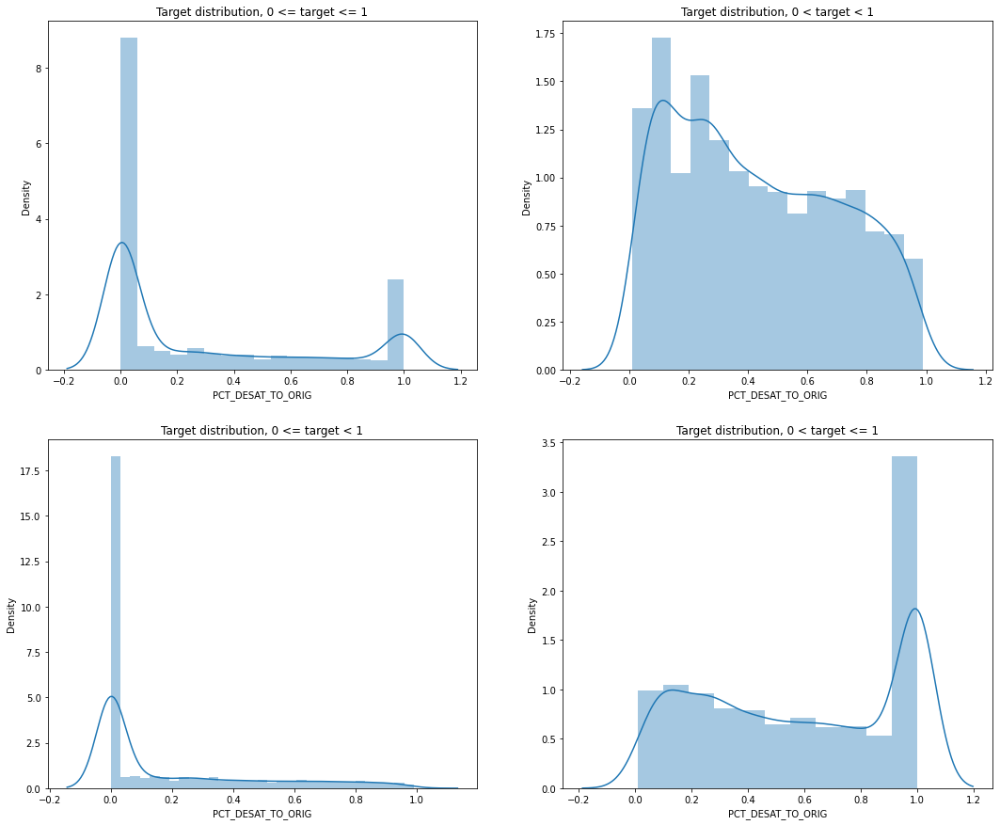

In [31]:
# show various types of target distribution
%matplotlib inline

_, ax = plt.subplots(figsize=(18, 15), ncols=2, nrows=2)
ax = ax.flatten()

sns.distplot(df_train['PCT_DESAT_TO_ORIG'], ax=ax[0])
ax[0].set_title('Target distribution, 0 <= target <= 1');

sns.distplot(df_train[df_train['PCT_DESAT_TO_ORIG'] != 0][df_train['PCT_DESAT_TO_ORIG'] != 1]['PCT_DESAT_TO_ORIG'], ax=ax[1])
ax[1].set_title('Target distribution, 0 < target < 1');

sns.distplot(df_train[df_train['PCT_DESAT_TO_ORIG'] != 1]['PCT_DESAT_TO_ORIG'], ax=ax[2])
ax[2].set_title('Target distribution, 0 <= target < 1');

sns.distplot(df_train[df_train['PCT_DESAT_TO_ORIG'] != 0]['PCT_DESAT_TO_ORIG'], ax=ax[3])
ax[3].set_title('Target distribution, 0 < target <= 1');

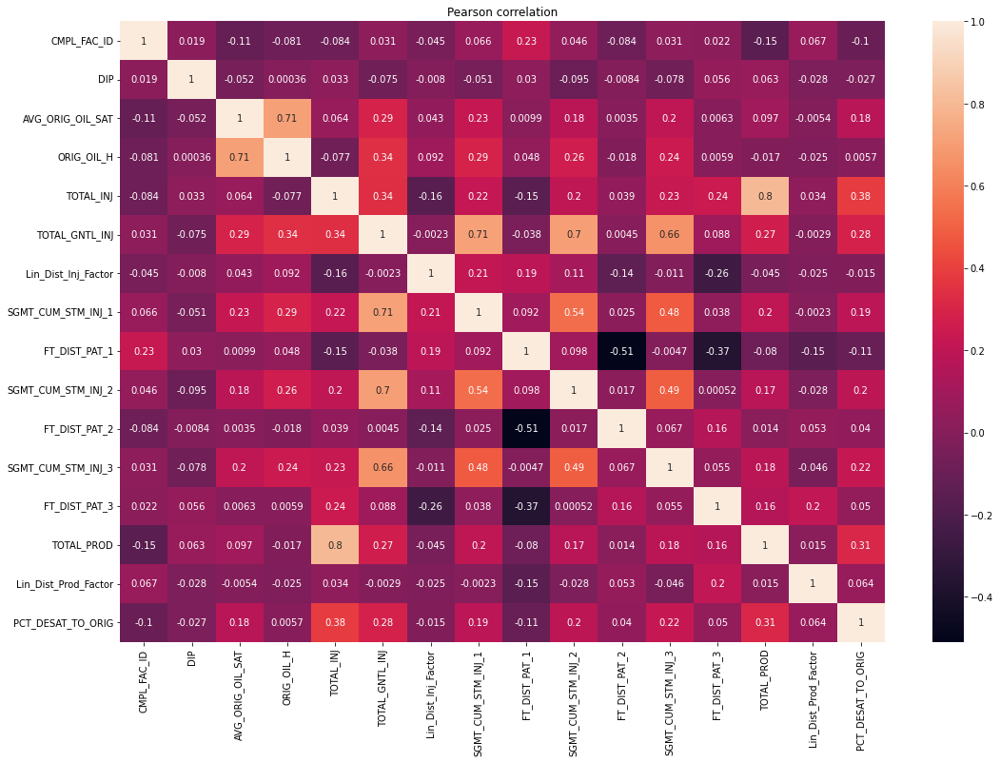

In [33]:
# corr. matrix(pearson) between all base features
%matplotlib inline

_, ax = plt.subplots(figsize=(18, 12))
sns.heatmap(df_train.corr(), annot=True, ax=ax)
ax.set_title('Pearson correlation');

## Total_prod / TOTAL_INJ / TOTAL_GNTL_INJ growth with time?

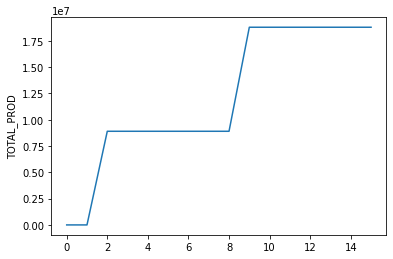

In [37]:
# plot changing TOTAL_PROD by time for 435 facility, x axis is time
%matplotlib inline

plot_cumulative_feature(df_train, 435, 'TOTAL_PROD')

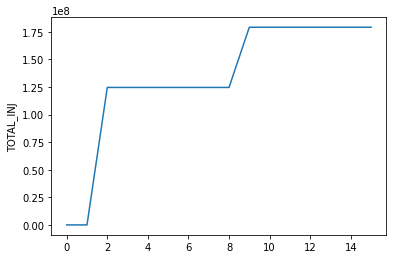

In [38]:
# plot changing TOTAL_INJ by time for 435 facility, x axis is time
%matplotlib inline

plot_cumulative_feature(df_train, 435, 'TOTAL_INJ')

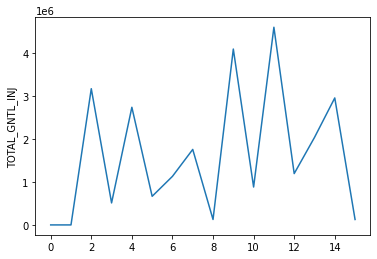

In [39]:
# plot changing TOTAL_GNTL_INJ by time for 435 facility, total_gntl_inj - for each sand, therefore such a schedule, x axis is time
%matplotlib inline

plot_cumulative_feature(df_train, 435, 'TOTAL_GNTL_INJ')

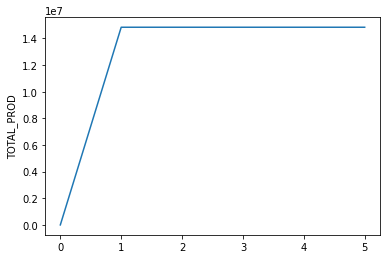

In [40]:
# plot changing TOTAL_PROD by time for 1009291 facility, x axis is time
%matplotlib inline

plot_cumulative_feature(df_train, 1009291, 'TOTAL_PROD')

## Number of steam injectors 
The presence of a steam injectors is determined by non NAN values of
SGMT_CUM_STM_INJ_n and FT_DIST_PAT_n

<AxesSubplot:ylabel='Frequency'>

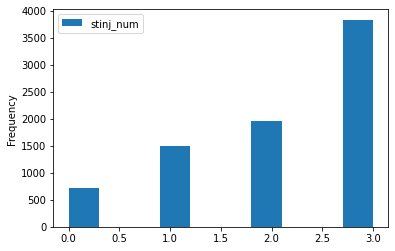

In [105]:
# number of steam injectors, plot distribution of steam injectors number
%matplotlib inline

df_preproc['stinj_num'] = df_preproc.apply(get_sinjectors_num, axis=1)
df_preproc.plot(y='stinj_num', kind='hist')

In [56]:
# steam unjectors num and mean target

for i in range(4):
    mean_t = df_preproc[df_preproc['stinj_num'] == i]['PCT_DESAT_TO_ORIG'].mean()
    print(f'Mean target {mean_t} for meas. with {i} steam injectors')


Mean target 0.19675034867503485 for meas. with 0 steam injectors
Mean target 0.19910487641950572 for meas. with 1 steam injectors
Mean target 0.248734693877551 for meas. with 2 steam injectors
Mean target 0.3700313315926893 for meas. with 3 steam injectors


<AxesSubplot:>

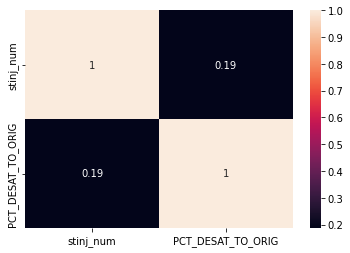

In [57]:
# steam injectors number and target correlation(pearson)
%matplotlib inline

sns.heatmap(df_preproc[['stinj_num', 'PCT_DESAT_TO_ORIG']].corr(), annot=True)

## "Time based" features

* **seq_num_un**
; Number of each measurement for "CMPL_FAC_ID SAND" group
* **seq_num_n**
; Same as seq_num_un but normalized(0..1)
* **fcl_life_time_un**
; Lifetime in days for measurements of facility in relation to the first measurement date of facility
* **fcl_life_time_n**
; Same as fcl_life_time_un but normalized(0..1)

* **fcl_sand_life_time_un**
; Lifetime in days for measurements of facility in relation to the first measurement date of facility+sand
* **fcl_sand_life_time_un**
; Same as fcl_life_time_un but normalized(0..1)
* **first_fcl_month**
; Number of first month of measurement for facility

In [107]:
# get new time based features

df_preproc['SURV_DTE'] = df_preproc['SURV_DTE'].map(get_surv_dte)

df_preproc = get_seq_num(df_preproc, res_feature_name='seq_num_n', normalize=True)
df_preproc = get_seq_num(df_preproc, res_feature_name='seq_num_un', normalize=False)
df_preproc = get_life_time(df_preproc, res_feature_name='fcl_life_time_n', normalize=True)
df_preproc = get_life_time(df_preproc, res_feature_name='fcl_life_time_un', normalize=False)
df_preproc = get_life_time(df_preproc, group=['CMPL_FAC_ID', 'SAND'], res_feature_name='fcl_sand_life_time_n', normalize=True)
df_preproc = get_life_time(df_preproc, group=['CMPL_FAC_ID', 'SAND'], res_feature_name='fcl_sand_life_time_un', normalize=False)
df_preproc = get_first_fcl_month(df_preproc, res_feature_name='first_fcl_month')

<AxesSubplot:>

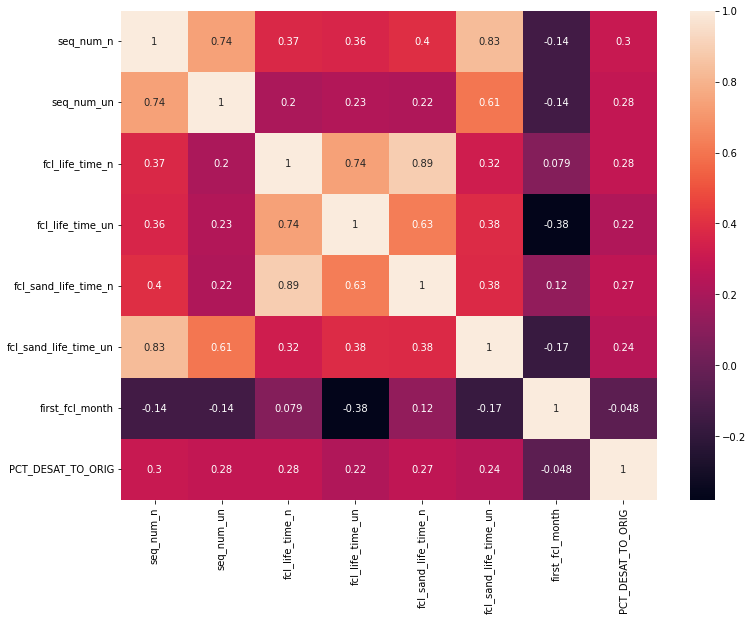

In [62]:
# timebased features and target correlation
%matplotlib inline

new_features = [
    'seq_num_n', 'seq_num_un',
    'fcl_life_time_n', 'fcl_life_time_un',
    'fcl_sand_life_time_n', 'fcl_sand_life_time_un',
    'first_fcl_month',
    'PCT_DESAT_TO_ORIG'
]

_, ax = plt.subplots(figsize=(12, 9))
sns.heatmap(df_preproc[new_features].corr(), annot=True, ax=ax)

<AxesSubplot:xlabel='first_fcl_month', ylabel='Density'>

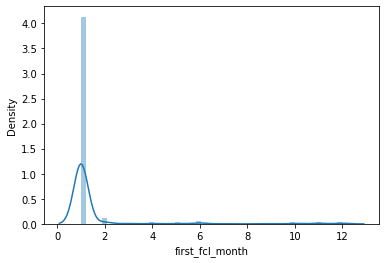

In [64]:
# distribution of first measurement of facility
%matplotlib inline

sns.distplot(df_preproc['first_fcl_month'])

In [66]:
# target- seq_num correlation for each SAND group

for s in df_preproc['SAND'].unique():
    _df = df_preproc[df_preproc['SAND'] == s]
    cor = _df[['PCT_DESAT_TO_ORIG', 'seq_num_n']].corr().iloc[0, 1]
    print(f'Pearson corr. for target seq_num_n features, SAND - {s}, corr: {cor}')

Pearson corr. for target seq_num_n features, SAND - TULS_D1, corr: 0.3176153862129659
Pearson corr. for target seq_num_n features, SAND - TULS_D2, corr: 0.341351924963692
Pearson corr. for target seq_num_n features, SAND - TULS_D3, corr: 0.3340291514859084
Pearson corr. for target seq_num_n features, SAND - TULS_E1, corr: 0.3207616489482306
Pearson corr. for target seq_num_n features, SAND - TULS_E2, corr: 0.3411245979909308
Pearson corr. for target seq_num_n features, SAND - TULS_E3, corr: 0.2790611543294657
Pearson corr. for target seq_num_n features, SAND - TULS_E4, corr: 0.24895662552212722
Pearson corr. for target seq_num_n features, SAND - TULS_E5, corr: 0.07511684910550011
Pearson corr. for target seq_num_n features, SAND - TULS_B5, corr: 0.3200236850605907
Pearson corr. for target seq_num_n features, SAND - TULS_C5, corr: 0.3856134016248825
Pearson corr. for target seq_num_n features, SAND - TULS_D5, corr: 0.3431024754203236
Pearson corr. for target seq_num_n features, SAND - T

## Mean/Std features for each facility

In [67]:
# get mean/std features for DIP, AVG_ORIG_OIL_SAT, ORIG_OIL_H in context of facility
dip_mean_map, dip_std_map = get_mean_std_feature(df_preproc, feature='DIP')
df_preproc['dip_m'] = df_preproc['CMPL_FAC_ID'].map(dip_mean_map)
df_preproc['dip_s'] = df_preproc['CMPL_FAC_ID'].map(dip_std_map)

OIL_SAT_mean_map, OIL_SAT_std_map = get_mean_std_feature(df_preproc, feature='AVG_ORIG_OIL_SAT')
df_preproc['OIL_SAT_m'] = df_preproc['CMPL_FAC_ID'].map(OIL_SAT_mean_map)
df_preproc['OIL_SAT_s'] = df_preproc['CMPL_FAC_ID'].map(OIL_SAT_std_map)

ORIG_OIL_mean_map, ORIG_OIL_std_map = get_mean_std_feature(df_preproc,feature='ORIG_OIL_H')
df_preproc['ORIG_OIL_m'] = df_preproc['CMPL_FAC_ID'].map(ORIG_OIL_mean_map)
df_preproc['ORIG_OIL_s'] = df_preproc['CMPL_FAC_ID'].map(ORIG_OIL_std_map)

# get mean/std features for TOTAL_GNTL_INJ in context of only last(by date) values
GNTL_INJ_mean_map, GNTL_INJ_std_map = get_mean_std_by_last_date_feature(df_preproc, 'TOTAL_GNTL_INJ')
df_preproc['GNTL_INJ_m'] = df_preproc['CMPL_FAC_ID'].map(GNTL_INJ_mean_map)
df_preproc['GNTL_INJ_s'] = df_preproc['CMPL_FAC_ID'].map(GNTL_INJ_std_map)

In [69]:
df_preproc.head()

,CMPL_FAC_ID,SAND,SURV_DTE,DIP,AVG_ORIG_OIL_SAT,ORIG_OIL_H,TOTAL_INJ,TOTAL_GNTL_INJ,Lin_Dist_Inj_Factor,SGMT_CUM_STM_INJ_1,FT_DIST_PAT_1,SGMT_CUM_STM_INJ_2,FT_DIST_PAT_2,SGMT_CUM_STM_INJ_3,FT_DIST_PAT_3,TOTAL_PROD,Lin_Dist_Prod_Factor,PCT_DESAT_TO_ORIG,stinj_num,seq_num_n,seq_num_un,fcl_life_time_n,fcl_life_time_un,fcl_sand_life_time_n,fcl_sand_life_time_un,first_fcl_month,dip_m,dip_s,OIL_SAT_m,OIL_SAT_s,ORIG_OIL_m,ORIG_OIL_s,GNTL_INJ_m,GNTL_INJ_s
0,435,TULS_D1,2012-10-25,0.05,0.7,21.06,1.246190e+08,3164720,0.269,NaN,NaN,551231.0,372.0,942465.0,465.0,8904160,0.410639,1.00,2,0.0,0.0,0.855456,8333.0,0.000710,1.0,1.0,0.07,0.011547,0.46,0.25,16.715714,10.830983,2.265613e+06,1.678213e+06
1,435,TULS_D1,2016-09-02,0.05,0.7,21.06,1.791845e+08,4085829,0.302,NaN,NaN,963379.0,372.0,994686.0,465.0,18796208,0.380935,1.00,2,1.0,1.0,1.000000,9741.0,1.000000,1408.0,1.0,0.07,0.011547,0.46,0.25,16.715714,10.830983,2.265613e+06,1.678213e+06
2,435,TULS_D2,1990-01-01,0.06,0.7,14.58,0.000000e+00,0,0.218,0.0,NaN,0.0,NaN,0.0,465.0,0,0.410639,0.00,1,0.0,0.0,0.000103,1.0,0.000103,1.0,1.0,0.07,0.011547,0.46,0.25,16.715714,10.830983,2.265613e+06,1.678213e+06
3,435,TULS_D2,2012-10-25,0.06,0.7,14.58,1.246190e+08,511013,0.218,NaN,NaN,NaN,NaN,232391.0,465.0,8904160,0.410639,0.79,1,0.5,1.0,0.855456,8333.0,0.855456,8333.0,1.0,0.07,0.011547,0.46,0.25,16.715714,10.830983,2.265613e+06,1.678213e+06
4,435,TULS_D2,2016-09-02,0.06,0.7,14.58,1.791845e+08,880407,0.229,NaN,NaN,NaN,NaN,416613.0,465.0,18796208,0.380935,1.00,1,1.0,2.0,1.000000,9741.0,1.000000,9741.0,1.0,0.07,0.011547,0.46,0.25,16.715714,10.830983,2.265613e+06,1.678213e+06


<AxesSubplot:>

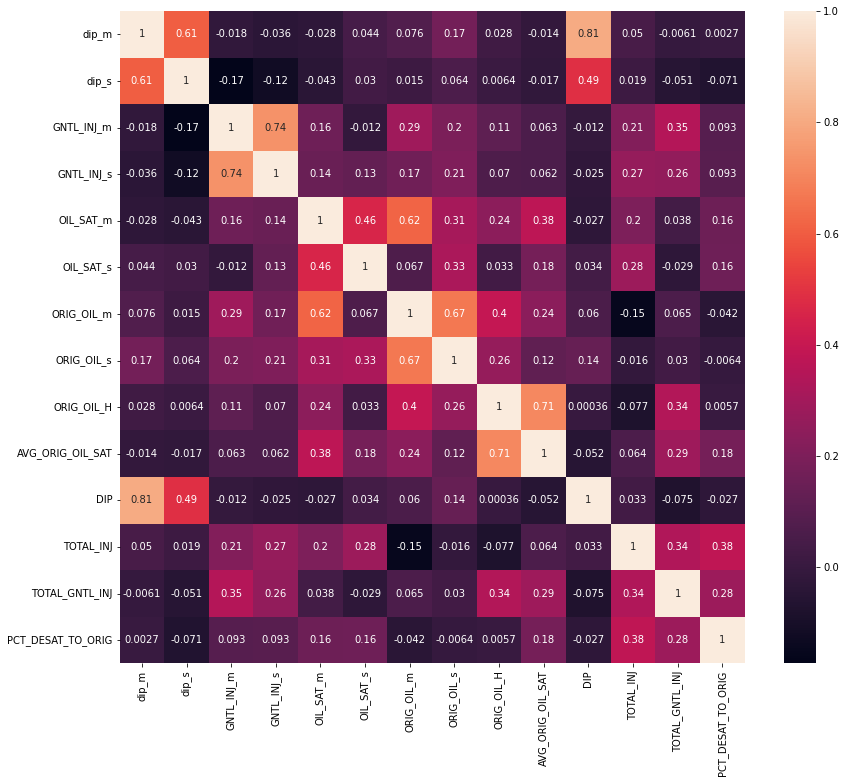

In [71]:
# plot pearson corr. matrix between this features and target
%matplotlib inline

new_features = [
    'dip_m', 'dip_s', 
    'GNTL_INJ_m', 'GNTL_INJ_s', 
    'OIL_SAT_m', 'OIL_SAT_s', 
    'ORIG_OIL_m', 'ORIG_OIL_s',
    'ORIG_OIL_H', 'AVG_ORIG_OIL_SAT', 'DIP', 'TOTAL_INJ', 'TOTAL_GNTL_INJ', 
    'PCT_DESAT_TO_ORIG'
]

_, ax = plt.subplots(figsize=(14, 12))
sns.heatmap(df_preproc[new_features].corr(), ax=ax, annot=True)

## Relationships between target and SAND, "sand based" features

In [72]:
# list of unique types of SAND

unique_sands = df_preproc['SAND'].unique()
unique_sands.sort()
print(f'Len un. sands: {len(unique_sands)}')
print(f'Unique sands: {unique_sands}')

Len un. sands: 20
Unique sands: ['TULS_B1' 'TULS_B2' 'TULS_B3' 'TULS_B4' 'TULS_B5' 'TULS_C1' 'TULS_C2'
 'TULS_C3' 'TULS_C4' 'TULS_C5' 'TULS_D1' 'TULS_D2' 'TULS_D3' 'TULS_D4'
 'TULS_D5' 'TULS_E1' 'TULS_E2' 'TULS_E3' 'TULS_E4' 'TULS_E5']


### Relationship between type of sand and target

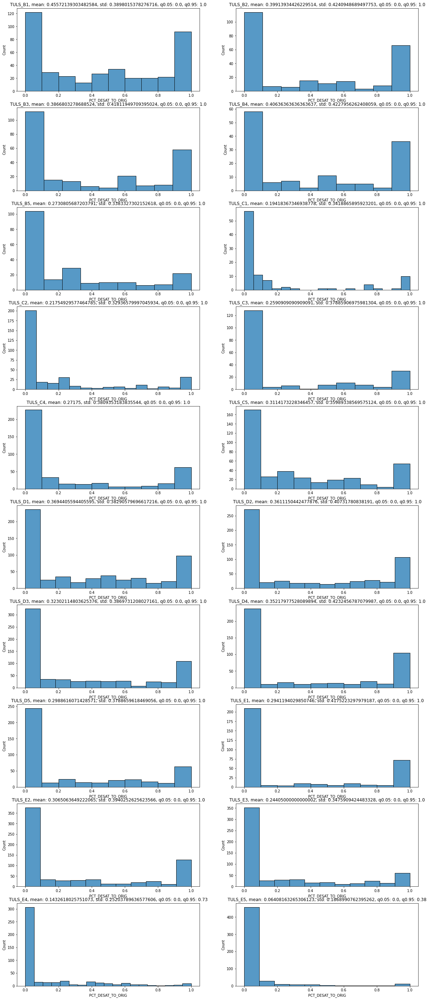

In [73]:
# types of sands, plot distribution of target for each sand type
%matplotlib inline

_, ax = plt.subplots(figsize=(20, 10*5), ncols=2, nrows=10)
ax = ax.flatten()

for i, us in enumerate(unique_sands):
    sand_group_target = df_preproc[df_preproc['SAND'] == us]['PCT_DESAT_TO_ORIG'] 
    sns.histplot(sand_group_target, ax=ax[i])
    info = f'{us}, mean: {sand_group_target.mean()}, std: {sand_group_target.std()}, q0.05: {sand_group_target.quantile(0.05)}, q0.95: {sand_group_target.quantile(0.95)}'
    ax[i].set_title(info)

### Relationship between target and sand group/number
Sand group one of B/C/D/E.
Number of sand - number in last of SAND string

In [78]:
# Get new features: sand_group, sand_number and number of sand groups(for facility)

grn = df_preproc['SAND'].map(sand_group_num_encoding).to_numpy()

df_preproc['SAND_group'] = [_[0] for _ in grn]
df_preproc['SAND_num'] = [_[1] for _ in grn]

df_gr_dum = pd.get_dummies(df_preproc['SAND_group'], prefix='SAND_group')
df_num_dum = pd.get_dummies(df_preproc['SAND_num'], prefix='SAND_num')

df_preproc = pd.concat([df_preproc, df_gr_dum, df_num_dum], axis=1)

# get number of groups
gr_map = get_sand_group_mapping(df_preproc) 
df_preproc['groups_num'] = df_preproc['CMPL_FAC_ID'].map(gr_map)

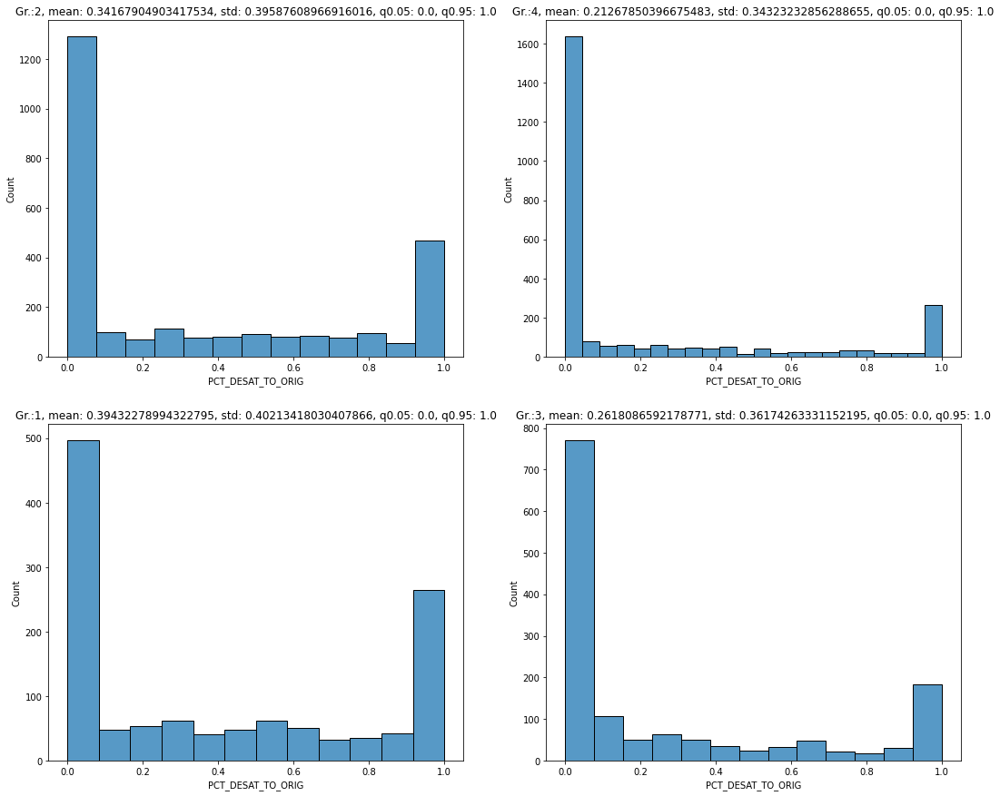

In [81]:
# types of sands groups, plot distribution of target for each sand group
%matplotlib inline

_, ax = plt.subplots(figsize=(18, 15), ncols=2, nrows=2)
ax = ax.flatten()

un_sand_group = df_preproc['SAND_group'].unique()
for i, us in enumerate(un_sand_group):
    sand_group_target = df_preproc[df_preproc['SAND_group'] == us]['PCT_DESAT_TO_ORIG'] 
    
    sns.histplot(sand_group_target, ax=ax[i])
    info = f'Gr.:{us}, mean: {sand_group_target.mean()}, std: {sand_group_target.std()}, q0.05: {sand_group_target.quantile(0.05)}, q0.95: {sand_group_target.quantile(0.95)}'
    ax[i].set_title(info)

<AxesSubplot:>

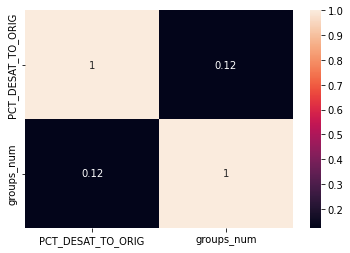

In [86]:
# corr. between number of sand groups and target???
%matplotlib inline

sns.heatmap(df_preproc[['PCT_DESAT_TO_ORIG', 'groups_num']].corr(), annot=True)

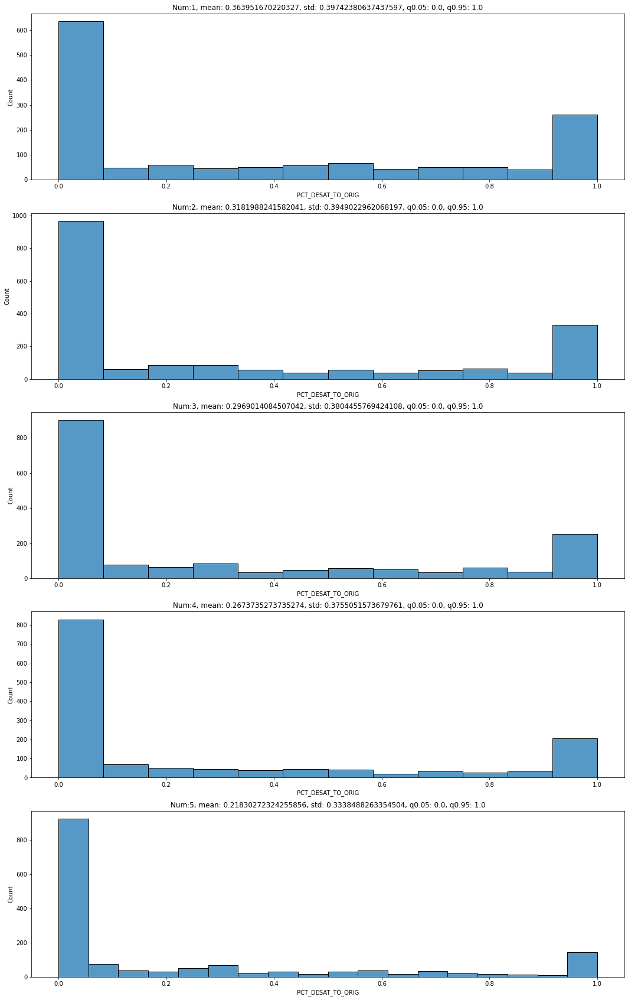

In [83]:
# types of sands nums, plot distribution of target for each sand number


_, ax = plt.subplots(figsize=(18, 30), ncols=1, nrows=5)
ax = ax.flatten()

un_sand_num = df_preproc['SAND_num'].unique()
for i, us in enumerate(un_sand_num):
    sand_num_tar = df_preproc[df_preproc['SAND_num'] == us]['PCT_DESAT_TO_ORIG'] 
    sns.histplot(sand_num_tar, ax=ax[i])
    info = f'Num:{us}, mean: {sand_num_tar.mean()}, std: {sand_num_tar.std()}, q0.05: {sand_num_tar.quantile(0.05)}, q0.95: {sand_num_tar.quantile(0.95)}'
    ax[i].set_title(info)

## Mean average orig saturation in sand groups

<AxesSubplot:>

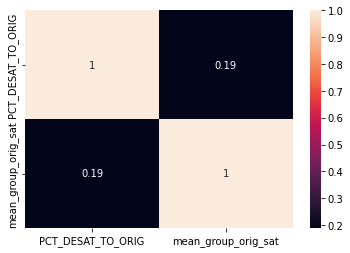

In [90]:
# pearson correlation between target and mean 'AVG_ORIG_OIL_SAT' by each sand_group of facility
%matplotlib inline

df_preproc = get_mean_osat(df_preproc, sgroup_col='SAND_group')
sns.heatmap(df_preproc[['PCT_DESAT_TO_ORIG', 'mean_group_orig_sat']].corr(), annot=True)

## Feature: steam_gntl_inj average my sand group
*** In context of facility

<AxesSubplot:>

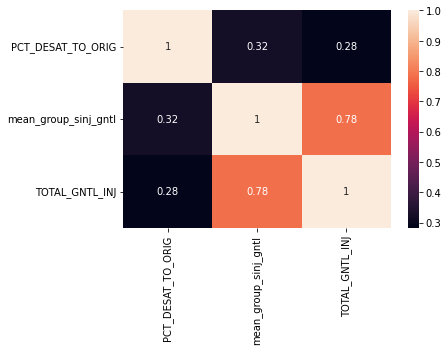

In [92]:
# pearson correlation between target and mean steam_gntl_inj by each sand_group of facility for a certain time
%matplotlib inline

df_preproc = get_sinj_by_sand_group(df_preproc, sgroup_col='SAND_group')
sns.heatmap(df_preproc[['PCT_DESAT_TO_ORIG', 'mean_group_sinj_gntl', 'TOTAL_GNTL_INJ']].corr(), annot=True)

## Normalize by max. features by CMPL_FAC_ID or CMPL_FAC_ID and SAND group
Normalize this features:
* total_prod_fac, normalize TOTAL_PROD by CMPL_FAC_ID group
* total_inj_fac, normalize TOTAL_INJ by CMPL_FAC_ID
* total_inj_fac_sand, normalize TOTAL_INJ by CMPL_FAC_ID and SAND group
* total_inj_gntl_fac_sand, normalized TOTAL_GNTL_INJ by CMPL_FAC_ID and SAND group
* total_inj_gntl_fac, normalized TOTAL_GNTL_INJ by CMPL_FAC_ID
* cum_stm[1/2/3]_fac_sand, normalized SGMT_CUM_STM_INJ_[1/2/3] by CMPL_FAC_ID and SAND
* norm_AVG_ORIG_OIL_SAT, normalized AVG_ORIG_OIL_SAT by CMPL_FAC_ID

In [93]:
# get dataframe with normalized features

df_preproc = get_norm_feature_by_group(df_preproc, group=['CMPL_FAC_ID'], feature='TOTAL_PROD', res_feature_name='total_prod_fac')
df_preproc = get_norm_feature_by_group(df_preproc, group=['CMPL_FAC_ID'], feature='TOTAL_INJ', res_feature_name='total_inj_fac')
df_preproc = get_norm_feature_by_group(df_preproc, group=['CMPL_FAC_ID', 'SAND'], feature='TOTAL_INJ', res_feature_name='total_inj_fac_sand')
df_preproc = get_norm_feature_by_group(df_preproc, group=['CMPL_FAC_ID', 'SAND'], feature='TOTAL_GNTL_INJ', res_feature_name='total_inj_gntl_fac_sand')
df_preproc = get_norm_feature_by_group(df_preproc, group=['CMPL_FAC_ID'], feature='TOTAL_GNTL_INJ', res_feature_name='total_inj_gntl_fac')
df_preproc = get_norm_feature_by_group(df_preproc, group=['CMPL_FAC_ID', 'SAND'], feature='SGMT_CUM_STM_INJ_1', res_feature_name='cum_stm1_fac_sand', fillna=0)
df_preproc = get_norm_feature_by_group(df_preproc, group=['CMPL_FAC_ID', 'SAND'], feature='SGMT_CUM_STM_INJ_2', res_feature_name='cum_stm2_fac_sand', fillna=0)
df_preproc = get_norm_feature_by_group(df_preproc, group=['CMPL_FAC_ID', 'SAND'], feature='SGMT_CUM_STM_INJ_3', res_feature_name='cum_stm3_fac_sand', fillna=0)
df_preproc = get_norm_feature_by_group(df_preproc, group=['CMPL_FAC_ID'], feature='AVG_ORIG_OIL_SAT', res_feature_name='norm_AVG_ORIG_OIL_SAT', fillna=0)

<AxesSubplot:>

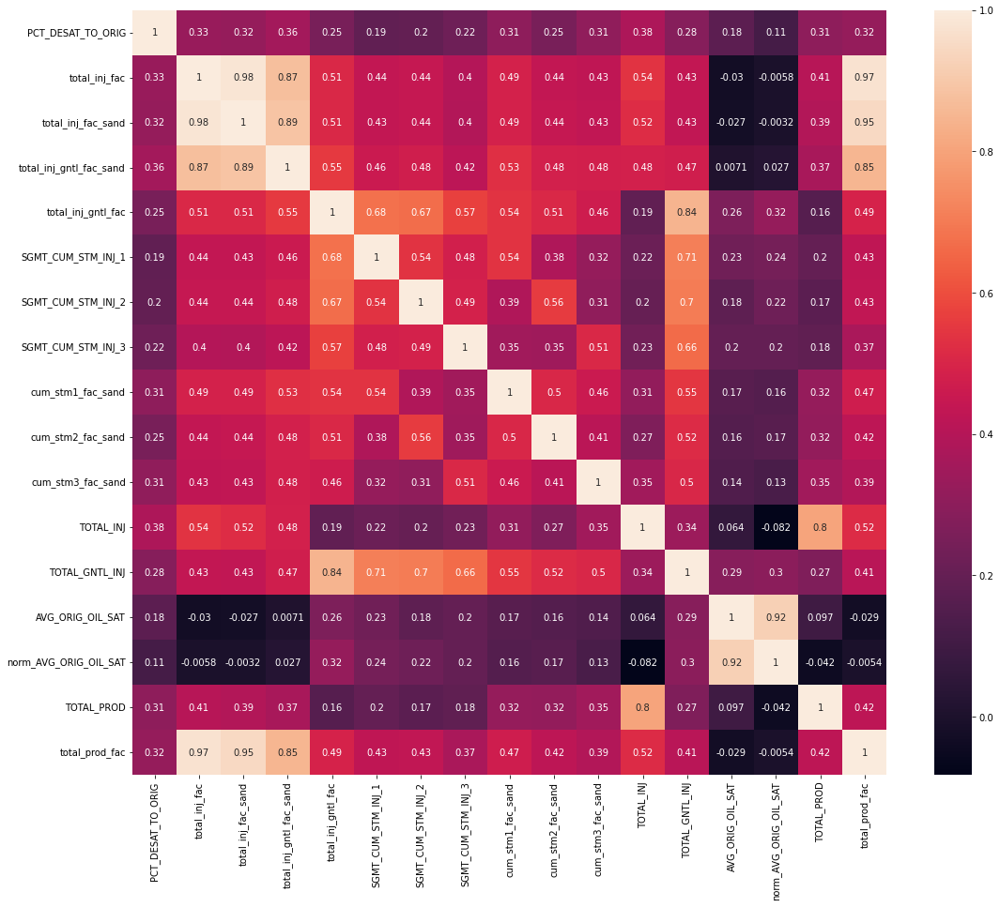

In [94]:
# pearson correlation between normalized features and target
%matplotlib inline

new_features = [
       'PCT_DESAT_TO_ORIG', 'total_inj_fac', 'total_inj_fac_sand', 'total_inj_gntl_fac_sand', 'total_inj_gntl_fac',
       'SGMT_CUM_STM_INJ_1', 'SGMT_CUM_STM_INJ_2', 'SGMT_CUM_STM_INJ_3',
       'cum_stm1_fac_sand', 'cum_stm2_fac_sand', 'cum_stm3_fac_sand',
       'TOTAL_INJ', 'TOTAL_GNTL_INJ', 'AVG_ORIG_OIL_SAT', 'norm_AVG_ORIG_OIL_SAT',
       'TOTAL_PROD', 'total_prod_fac'
]

_, ax = plt.subplots(figsize=(18, 15))
sns.heatmap(df_preproc[new_features].corr(), annot=True, ax=ax)

## Features of changing total_prod, total_inj, total_inj_gntl
Feature of difference between Xi-1 an Xi for total_prod, total_inj, total_inj_gntl features

In [96]:
df_preproc = get_feature_change_by_time(df_preproc, feature='TOTAL_INJ', new_feature_name='total_inj_change')
df_preproc = get_feature_change_by_time(df_preproc, feature='TOTAL_GNTL_INJ', new_feature_name='total_gntl_inj_change')
df_preproc = get_feature_change_by_time(df_preproc, feature='TOTAL_PROD', new_feature_name='total_prod_change')
df_preproc = get_feature_change_by_time(df_preproc, feature='TOTAL_INJ', new_feature_name='total_inj_change_p', normalize=True)
df_preproc = get_feature_change_by_time(df_preproc, feature='TOTAL_GNTL_INJ', new_feature_name='total_gntl_inj_change_p', normalize=True)
df_preproc = get_feature_change_by_time(df_preproc, feature='TOTAL_PROD', new_feature_name='total_prod_change_p', normalize=True)

cols = [
       'TOTAL_INJ', 'TOTAL_GNTL_INJ', 'TOTAL_PROD', 'PCT_DESAT_TO_ORIG',
       'total_inj_change', 'total_gntl_inj_change', 'total_prod_change',
       'total_inj_change_p', 'total_gntl_inj_change_p', 'total_prod_change_p'
]

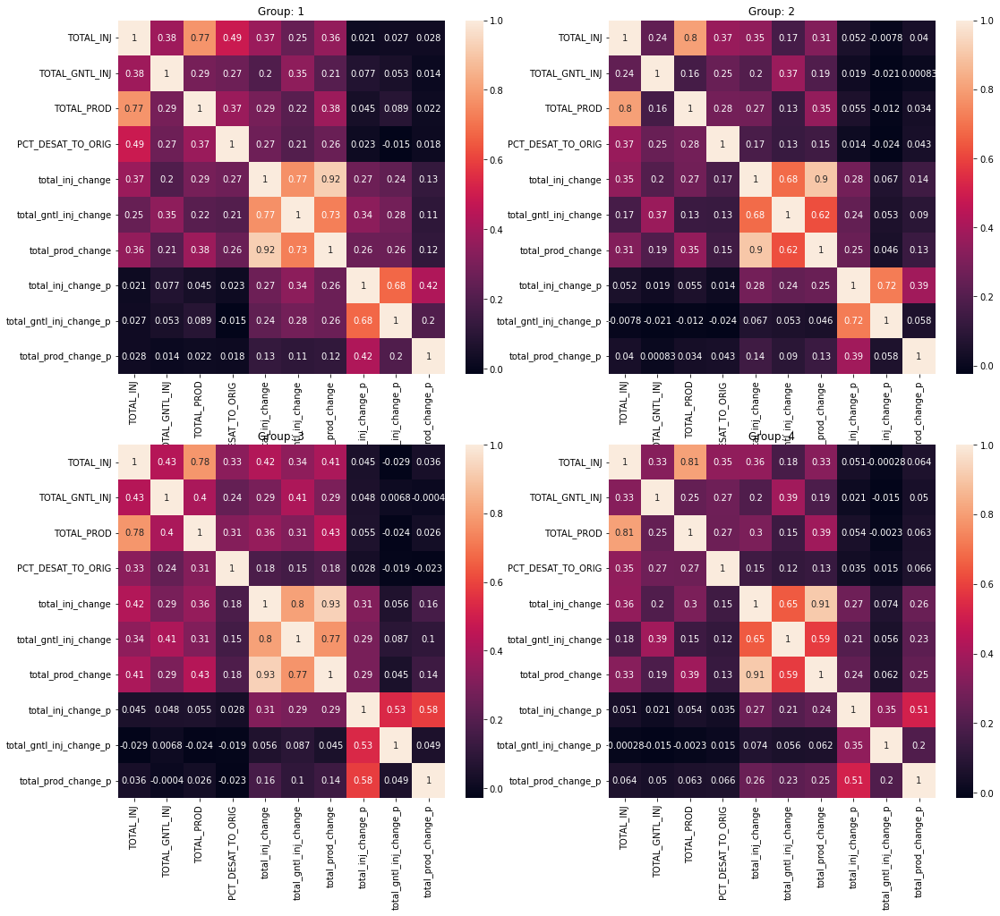

In [100]:
# pearson correlation for target and features_of_change for each sand group
%matplotlib inline

_, ax = plt.subplots(figsize=(18, 16), nrows=2, ncols=2)
ax = ax.flatten()

for i in range(4):
    sns.heatmap(df_preproc[df_preproc[f'SAND_group_{i+1}'] == 1][cols].corr(), annot=True, ax=ax[i])
    ax[i].set_title(f'Group: {i+1}')

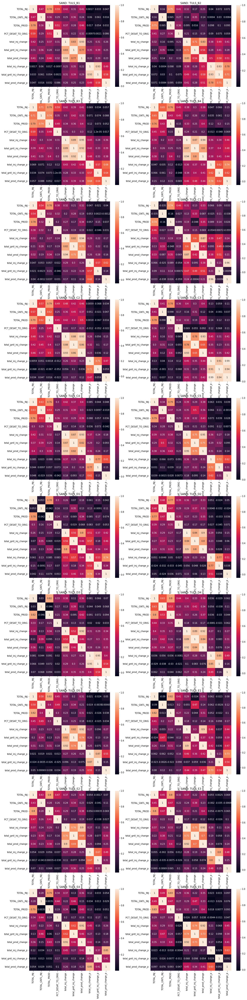

In [97]:
# pearson correlation for target and features_of_change for each sand type
%matplotlib inline


_, ax = plt.subplots(figsize=(18, 8*10), nrows=10, ncols=2)
ax = ax.flatten()

for i, sand_id in enumerate(np.sort(df_preproc['SAND'].unique())):
    sns.heatmap(df_preproc[df_preproc['SAND'] == sand_id][cols].corr(), annot=True, ax=ax[i])
    ax[i].set_title(f'SAND: {sand_id}')

## Traget distribution analysis
Problem: the target has a bimodal distribution, maybe there is a way to split the target into 2 distributions?

### Split target on bins

<AxesSubplot:xlabel='t_group', ylabel='Count'>

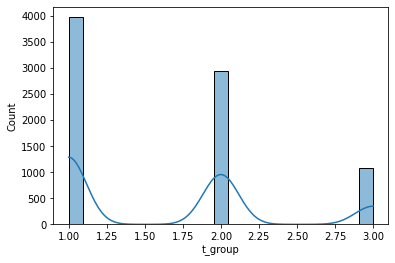

In [102]:
# split target by bins, 1: 0, 2: 0 < target < 1, 3: 1 and plot distribution of bins
%matplotlib inline

df_preproc['t_group'] = df_preproc['PCT_DESAT_TO_ORIG'].map(get_target_group)
sns.histplot(df_preproc['t_group'], kde=True)

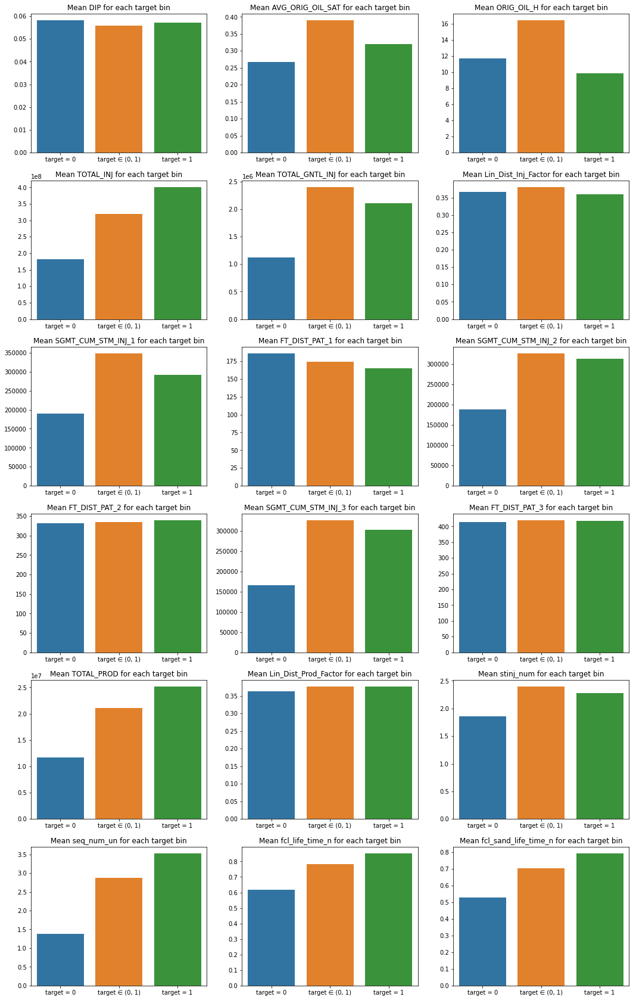

In [109]:
# show mean of features for each target bin
%matplotlib inline

needest_columns = [
    'DIP', 'AVG_ORIG_OIL_SAT', 'ORIG_OIL_H', 'TOTAL_INJ', 'TOTAL_GNTL_INJ',
    'Lin_Dist_Inj_Factor', 'SGMT_CUM_STM_INJ_1', 'FT_DIST_PAT_1', 'SGMT_CUM_STM_INJ_2',
    'FT_DIST_PAT_2', 'SGMT_CUM_STM_INJ_3', 'FT_DIST_PAT_3', 'TOTAL_PROD', 'Lin_Dist_Prod_Factor',
    'stinj_num', 'seq_num_un', 'fcl_life_time_n', 'fcl_sand_life_time_n'
]

_, ax = plt.subplots(figsize=(18, 30), ncols=3, nrows=6)
ax = ax.flatten()

for i, f in enumerate(needest_columns):
    info = df_preproc.groupby(by='t_group')[f].mean()
    info.index = ['target = 0', 'target ∈ (0, 1)', 'target = 1']
    
    sns.barplot(x=info.index, y=info.values, ax=ax[i])
    ax[i].set_title(f'Mean {f} for each target bin')

### Try clustering data
The idea is to cluster dimensions in such a way as to split the target distribution into 2 parts - 1st with one peak (value 0), 2nd with another peak (value 1)

In [113]:
# create X np array for training cluster models

needest_columns = [
    'DIP', 'AVG_ORIG_OIL_SAT', 'ORIG_OIL_H', 'TOTAL_INJ', 'TOTAL_GNTL_INJ',
    'Lin_Dist_Inj_Factor', 'SGMT_CUM_STM_INJ_1', 'FT_DIST_PAT_1', 'SGMT_CUM_STM_INJ_2',
    'FT_DIST_PAT_2', 'SGMT_CUM_STM_INJ_3', 'FT_DIST_PAT_3', 'TOTAL_PROD', 'Lin_Dist_Prod_Factor'
]
needest_sand_columns = [c for c in df_preproc.columns if 'SAND_' in c]
needest_columns = needest_columns + needest_sand_columns +\
                      ['stinj_num', 'seq_num_un', 'fcl_life_time_n', 'fcl_sand_life_time_n']

X = df_preproc[needest_columns].fillna(-1)
X = X.to_numpy()

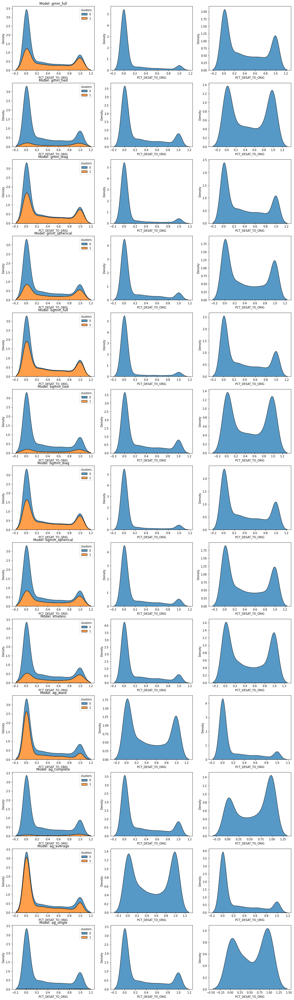

In [115]:
# plot results of clustering for different models
%matplotlib inline

# number of components/clusters
n_cl = 2
# cluster models
cluster_2c_models ={
    'gmm_full': GaussianMixture(n_components=n_cl, random_state=42, covariance_type='full'),
    'gmm_tied': GaussianMixture(n_components=n_cl, random_state=42, covariance_type='tied'),
    'gmm_diag': GaussianMixture(n_components=n_cl, random_state=42, covariance_type='diag'),
    'gmm_spherical': GaussianMixture(n_components=n_cl, random_state=42, covariance_type='spherical'),
    
    'bgmm_full': BayesianGaussianMixture(n_components=n_cl, random_state=42, covariance_type='full'),
    'bgmm_tied': BayesianGaussianMixture(n_components=n_cl, random_state=42, covariance_type='tied'),
    'bgmm_diag': BayesianGaussianMixture(n_components=n_cl, random_state=42, covariance_type='diag'),
    'bgmm_spherical': BayesianGaussianMixture(n_components=n_cl, random_state=42, covariance_type='spherical'),
    
    'kmeans': KMeans(n_clusters=n_cl, random_state=42),
    
    'ag_ward': AgglomerativeClustering(n_clusters=n_cl, linkage='ward'),
    'ag_complete': AgglomerativeClustering(n_clusters=n_cl, linkage='complete'),
    'ag_average': AgglomerativeClustering(n_clusters=n_cl, linkage='average'),
    'ag_single': AgglomerativeClustering(n_clusters=n_cl, linkage='single')
}

models_len = len(cluster_2c_models.keys())
_, ax = plt.subplots(figsize=(18, 5*models_len), ncols=3, nrows=models_len)
ax = ax.flatten()

for i, (n, model) in enumerate(cluster_2c_models.items()):
    model.fit(X)
    
    if hasattr(model, 'predict'):
        clusters = model.predict(X)
    else:
        clusters = model.labels_     
    df_preproc['clusters'] = clusters
    
    ax[3*i].set_title(f'Model: {n}')
    sns.kdeplot(data=df_preproc, x='PCT_DESAT_TO_ORIG', hue='clusters', multiple="stack", ax=ax[3*i])
    sns.kdeplot(data=df_preproc[df_preproc['clusters'] == 0], x='PCT_DESAT_TO_ORIG', multiple="stack", ax=ax[3*i + 1])
    sns.kdeplot(data=df_preproc[df_preproc['clusters'] == 1], x='PCT_DESAT_TO_ORIG', multiple="stack", ax=ax[3*i + 2])

# Experiments


1.1 exp.
```
Try predict OIL desaturation using next features:
'DIP', 'AVG_ORIG_OIL_SAT', 'ORIG_OIL_H', 'TOTAL_INJ', 'TOTAL_GNTL_INJ',
'Lin_Dist_Inj_Factor', 'SGMT_CUM_STM_INJ_1', 'FT_DIST_PAT_1', 'SGMT_CUM_STM_INJ_2', 
'FT_DIST_PAT_2', 'SGMT_CUM_STM_INJ_3', 'FT_DIST_PAT_3', 'TOTAL_PROD', 'Lin_Dist_Prod_Factor'

Dont use SAND and DATE features. Traing RandomTree model with next params:
n_trees = 3000
criterion = 'squared_error'

Result:
RMSE(Train, test_size=0.2) - 0.2529
RMSE(LB, test_size=0.2) - 0.3478
RMSE(LB, all data) - 0.346
```

1.2 exp.
```
All data the same as in 1.1, but train 4 gradient boosting models(by 4 fold cross validation) and predict 
target by 4 models

Training gradient boosting model with next params:
n_trees = 400
lr = 0.1

Result:
RMSE(Train CV4) - 0.2423
RMSE(LB) - 0.3512
```

1.3 exp.
```
All data the same as in 1.1(but normalize features), train 4 linear regression 
models(by 4 fold cross validation) and predict target by 4 models.

Training gradient LinReg model with next params:
lr = 0.1

Result:
RMSE(Train CV4) - 0.3699
RMSE(LB) - 0.383
```

1.4 exp.
```
All data the same as in 1.1 but add additional features:
1. Number of steam injectors(if SGMT_CUM_STM_INJ_N and FT_DIST_PAT_N columns is not nan,
is steam injector)
2. Move steam injectors columns in left columns side
3. Add SAND OHE feature
4. 1+2+3

Train random forest model.

Training gradient boosting model with next params:
n_trees = 3000

Result:
1:
    RMSE(CV4) - 0.2517 
2:
    RMSE(CV4) - 0.2522
3:
    RMSE(CV4) - 0.2475
4:
    RMSE(CV4) - 0.2478
    RMSE(LB, test_size=0.2) - 0.3398
    RMSE(LB, all data) - 0.338
```


METRIC.1 exp.
**_!!!WARNING!!! NEW CV STRATEGY - GroupKFold(group=CMPL_FAC_ID)_**
```
The estimate was overestimated due to the fact that the model was 
looking for the "oil well - target" relationship instead of the 
"features - target" relationship.....

Train_Test_split without shuffle give me lower RMSE =~-0.34 on exp 1.4....
Try compute all scores on GroupKFold(cv=4), group is oil facility(CMPL_FAC_ID)
Compute scores for this models:

1. RF model from exp 1.1, results
    RMSE(groupkf CV4) - 0.3469
    
2. GradBoost model from exp 1.2
    RMSE(groupkf CV4) - 0.3519

3. LinReg model from exp 1.3
    RMSE(groupkf CV4) - 0.3709
    
4. RF model from exp 1.4, results:
   RMSE(groupkf CV4) -  0.3395

CONCLUSION - this CV strategy high correlated with LB, in next exps i will use 
this CV strategy 
```



1.5 exp.
```
Try time features:
plifetime_fcl, plifetime_sand_fcl, lifetime_fcl, lifetime_sand_fcl,
fcl_sand_seq_num, first_life_month

1. Tuned RF model_exp1.4 + normalized fcl_sand_seq_num
    RMSE(groupKF CV4) - 0.3309
    RMSE(LB, trained on all data) - 0.3241
    
2. Tuned RF model_exp1.4 + seq_num_un, fcl_life_time, fcl_sand_life_time
    RMSE(groupKF CV4) - 0.3274
    RMSE(LB, trained on all data) - 0.3244
    
3. As in 2, but add sands_num
    RMSE(groupKF CV4) - 0.3281
    RMSE(LB, trained on all data) - 0.3245
```


1.6 exp.
```
Try other method OHE of SAND:
1/4 codes of types of SAND
1/5 codes of number of SAND

Try stacking for best solution

1. 1.5exp Solution + new sand OHE features <- lost .py scripts...
    RMSE(groupKF CV4) - 0.3280
    
2. Stacking with features preprocessing from exp. 1.5
    RF_exp1.5 + SVR + LGBMRegressor, final_estimator - RidgeCV
    RMSE(groupKF CV4) - 0.3258
    RMSE(LB, trained on all data) - 0.3204
```

1.7 exp.
```
Add remaining features to exp1.5.2 approach:
1. ADD TOTAL_INJ, TOTAL_GNTL_INJ, TOTAL_PROD on normalized by facility/facility+sand variant
    RMSE(groupKF CV4) - 0.3243
    RMSE(LB, trained on all data) - 0.3222
    
2. ADD SGMT_CUM_STM_INJ_[1/2/3] on normalized by facility/facility+sand variant
    RMSE(groupKF CV4) - 0.3257

3. ADD sand group feature B/C/E/D
    RMSE(groupKF CV4) - 0.3265

4. Mean/STD by facility, facility+SAND features
    RMSE(groupKF CV4) - 0.3273

5. Change of TOTAL_INj, TOTAL_GNTL_INJ, TOTAL_PROD
    RMSE(groupKF CV4) - 0.3272
    
6. Mean ORIG_SAT and TOTAL_GNTL_INJ for each sand group
    RMSE(groupKF CV4) - 0.3260

7. Time feature(year)
    RMSE(groupKF CV4) - 0.3277

8. Number of sand group feature
    RMSE(groupKF CV4) - 0.3265

9. 1 + 2 + 3 + 6 + 8 exps.
    RMSE(groupKF CV4) - 0.3211
    RMSE(LB, trained on all data) - 0.3168
    
10. STACKING data all the same as in 9
    RMSE(groupKF CV4) - 0.32029
    RMSE(LB, trained on all data) - 0.3131
```

1.8 exp.
```
Feature selection
1. Permutation importance, WARNING n_trees=300
First - bad features
              Weight               Feature
0    0.0008  ± 0.0012         FT_DIST_PAT_3
1    0.0001  ± 0.0001          SAND_TULS_C3
2    0.0001  ± 0.0010  Lin_Dist_Prod_Factor
3    0.0000  ± 0.0000          SAND_TULS_C1
4    0.0000  ± 0.0003            groups_num
5    0.0000  ± 0.0001        steam_inj_nums
6    0.0000  ± 0.0005     cum_stm2_fac_sand
7   -0.0000  ± 0.0001          SAND_TULS_B3
8   -0.0000  ± 0.0002          SAND_group_4
9   -0.0000  ± 0.0002          SAND_TULS_E3
10  -0.0000  ± 0.0002          SAND_TULS_B2
11  -0.0000  ± 0.0001          SAND_TULS_C4
12  -0.0000  ± 0.0002            SAND_num_4
13  -0.0000  ± 0.0001          SAND_TULS_D5
14  -0.0001  ± 0.0002          SAND_TULS_D4
15  -0.0001  ± 0.0001          SAND_TULS_B5
16  -0.0001  ± 0.0001            SAND_num_3
17  -0.0001  ± 0.0002          SAND_TULS_C5
18  -0.0001  ± 0.0004    fcl_sand_life_time
19  -0.0001  ± 0.0002          SAND_TULS_D3
20  -0.0001  ± 0.0001          SAND_TULS_B4
21  -0.0001  ± 0.0002          SAND_TULS_C2
22  -0.0001  ± 0.0007                   DIP
23  -0.0002  ± 0.0002          SAND_TULS_D2
24  -0.0002  ± 0.0003          SAND_group_3
25  -0.0002  ± 0.0002            SAND_num_2
26  -0.0002  ± 0.0003          SAND_TULS_B1
27  -0.0002  ± 0.0003          SAND_TULS_E1
28  -0.0003  ± 0.0003          SAND_group_1
29  -0.0003  ± 0.0002          SAND_TULS_E4
30  -0.0003  ± 0.0004        total_prod_fac
31  -0.0004  ± 0.0004          SAND_group_2
32  -0.0004  ± 0.0003          SAND_TULS_D1
33  -0.0005  ± 0.0007    SGMT_CUM_STM_INJ_2
34  -0.0006  ± 0.0004          SAND_TULS_E2
35  -0.0006  ± 0.0005            SAND_num_5
36  -0.0007  ± 0.0009         FT_DIST_PAT_2
37  -0.0008  ± 0.0005         total_inj_fac
38  -0.0008  ± 0.0006          SAND_TULS_E5
39  -0.0009  ± 0.0006    SGMT_CUM_STM_INJ_1
40  -0.0012  ± 0.0011   Lin_Dist_Inj_Factor
41  -0.0012  ± 0.0007            SAND_num_1
42  -0.0013  ± 0.0008     cum_stm3_fac_sand
43  -0.0013  ± 0.0006         fcl_life_time
44  -0.0014  ± 0.0010            TOTAL_PROD
45  -0.0021  ± 0.0011    SGMT_CUM_STM_INJ_3
46  -0.0025  ± 0.0016            ORIG_OIL_H
47  -0.0026  ± 0.0014         FT_DIST_PAT_1
48  -0.0031  ± 0.0012        TOTAL_GNTL_INJ
49  -0.0063  ± 0.0018            seq_num_un
50  -0.0065  ± 0.0029   mean_group_orig_sat
51  -0.0075  ± 0.0016     cum_stm1_fac_sand
52  -0.0082  ± 0.0025      AVG_ORIG_OIL_SAT
53  -0.0111  ± 0.0032             TOTAL_INJ
54  -0.0112  ± 0.0016    total_inj_fac_sand
55  -0.0118  ± 0.0027  mean_group_sinj_gntl

2. Choice features using backward features elimination 
    


1.1 Choised 'FT_DIST_PAT_3', 'Lin_Dist_Prod_Factor', 'groups_num', 'steam_inj_nums' features
    RMSE(groupKF CV4) - 0.3189
1.2 1.1 + stacking from 1.7.10 
    RMSE(groupKF CV4) - 0.3173
    RMSE(LB, trained on all data) - 0.3112
```

# Modeling

## Code

In [179]:
class LinearRFStacking():
    def __init__(self, rf_tree_num=3000, gb_tree_num=500, rf_tree_max_f=0.1, random_state=42):
        self.model = StackingRegressor(
            estimators=[
                ('rf1', RandomForestRegressor(n_estimators=rf_tree_num, random_state=random_state, criterion='squared_error', max_features=rf_tree_max_f)),
                ('SVR', SVR()),
                ('gbm', lgb.LGBMRegressor(n_estimators=gb_tree_num))
            ],
            final_estimator=RidgeCV()
        )
        
    def fit(self, X, y):
        """Fit stacking model.
    
        Parameters
        ----------
        
        X : np.ndarray
            Numpy train dataset 
        y : np.ndarray
            Numpy train dataset with labels
        """
        
        self.model.fit(X, y)
        return self
    
    def predict(self, X):
        """Predict target.
    
        Parameters
        ----------
        
        X : np.ndarray
            Numpy predictors matrix
        """
        
        return self.model.predict(X)
    
    
class FinalPreprocessor():
    
    def __init__(self, bad_features=['Lin_Dist_Prod_Factor', 'Lin_Dist_Inj_Factor'], 
                 target_col='PCT_DESAT_TO_ORIG', 
                 datetime_col='SURV_DTE', 
                 facility_id_col='CMPL_FAC_ID',
                 sand_col='SAND'):
        
        # init datetime col, facility_id col and sand columns
        self.bad_features = bad_features
        self.target_col = target_col
        self.datetime_col = datetime_col
        self.facility_id = facility_id_col
        self.sand_col = sand_col
        

    def __call__(self, df):
        """Preprocess dataframe.
    
        Parameters
        ----------
    
        df : DataFrame
            source dataframe
        """
        
        # remove bad features and convert str date in datetime object
        prep_df = self.remove_bad_variables(df)
        prep_df['SURV_DTE'] = prep_df['SURV_DTE'].map(self.get_surv_dte)
        base_features = prep_df.columns
        new_features = []

        # add time based features
        prep_df = self.get_seq_num(prep_df, res_feature_name='seq_num_un', normalize=False)
        prep_df = self.get_life_time(prep_df, group=['CMPL_FAC_ID'], res_feature_name='fcl_life_time', normalize=True)
        prep_df = self.get_life_time(prep_df, group=['CMPL_FAC_ID', 'SAND'], res_feature_name='fcl_sand_life_time', normalize=True)
        new_features += ['seq_num_un', 'fcl_life_time', 'fcl_sand_life_time']

        
        # add normalized total inj features
        prep_df = self.get_norm_feature_by_group(prep_df, group=['CMPL_FAC_ID'], feature='TOTAL_INJ',
                                                 res_feature_name='total_inj_fac')
        prep_df = self.get_norm_feature_by_group(prep_df, group=['CMPL_FAC_ID', 'SAND'], feature='TOTAL_GNTL_INJ',
                                                 res_feature_name='total_inj_fac_sand')
        prep_df = self.get_norm_feature_by_group(prep_df, group=['CMPL_FAC_ID'], feature='TOTAL_PROD',
                                                 res_feature_name='total_prod_fac')
        new_features += ['total_inj_fac', 'total_inj_fac_sand', 'total_prod_fac']
        
        
        # add normalized SGMT_CUM_STM_INJ_[1/2/3] features, fillna=-1
        prep_df = self.get_norm_feature_by_group(prep_df, group=['CMPL_FAC_ID', 'SAND'], feature='SGMT_CUM_STM_INJ_1',
                                                 res_feature_name='cum_stm1_fac_sand', fillna=-1)
        prep_df = self.get_norm_feature_by_group(prep_df, group=['CMPL_FAC_ID', 'SAND'], feature='SGMT_CUM_STM_INJ_2',
                                                 res_feature_name='cum_stm2_fac_sand', fillna=-1)
        prep_df = self.get_norm_feature_by_group(prep_df, group=['CMPL_FAC_ID', 'SAND'], feature='SGMT_CUM_STM_INJ_3',
                                                 res_feature_name='cum_stm3_fac_sand', fillna=-1)
        new_features += ['cum_stm1_fac_sand', 'cum_stm2_fac_sand', 'cum_stm3_fac_sand']
        
        # add sand group and sand number OHE featuers
        grn = prep_df['SAND'].map(self.sand_group_num_encoding).to_numpy()
        prep_df['SAND_group'] = [_[0] for _ in grn]
        prep_df['SAND_num'] = [_[1] for _ in grn]

        df_gr_dum = pd.get_dummies(prep_df['SAND_group'], prefix='SAND_group')
        df_num_dum = pd.get_dummies(prep_df['SAND_num'], prefix='SAND_num')
        prep_df = pd.concat([prep_df, df_gr_dum, df_num_dum], axis=1)
        new_features += list(df_gr_dum.columns) + list(df_num_dum.columns)
        
        # add sand group number feature
        gr_map = prep_df.groupby(by='CMPL_FAC_ID')['SAND_group'].nunique().tolist()
        gr_map = dict(zip(prep_df['CMPL_FAC_ID'].unique().tolist(), gr_map))
        prep_df['groups_num'] = prep_df['CMPL_FAC_ID'].map(gr_map)
        new_features += ['groups_num']

        # add mean sand group features
        prep_df = self.get_mean_osat(prep_df, sgroup_col='SAND_group')
        prep_df = self.get_sinj_by_sand_group(prep_df, sgroup_col='SAND_group')
        new_features += ['mean_group_orig_sat', 'mean_group_sinj_gntl']
        
        # get num of steam injectors
        prep_df['steam_inj_nums'] = prep_df.apply(self.get_sinjectors_num, axis=1)
        new_features += ['steam_inj_nums']

        # move steam injector info columns
        prep_df = self.move_sinjectors_columns(prep_df, verbosity=True)

        # add sand features
        df_ohe = pd.get_dummies(data=prep_df['SAND'], prefix='SAND')
        prep_df = pd.concat([prep_df, df_ohe], axis=1)
        new_features += list(df_ohe.columns)
        
        features = [i for i in base_features if i not in [self.facility_id] + [self.sand_col] + [self.datetime_col] + self.bad_features] 
        features += new_features
        prep_df = prep_df[features]
        prep_df = prep_df.fillna(-1)
        
        return prep_df
    
    
    def get_surv_dte(self, s):
        """Convert string date(format month/day/year of year-month-day) in datetime object.
    
        Parameters
        ----------
    
        s : str
            Date string
        """
        if '/' in s:
            return datetime.strptime(s, '%m/%d/%Y')
        else:
            return datetime.strptime(s, '%Y-%m-%d')
    
    
    # remove bad features after data update
    def remove_bad_variables(self, df):
        """Checks dataframe for variables and drops 
        them if present.
    
        Parameters
        ----------
    
        df: DataFrame
            Source DataFrame
        """
    
        col_names = list(df.columns)
        for i in ['RMNG_OIL_H', 'GAS_H']:
            if i in col_names:
                df = df.drop(i, axis=1)
        return df


    # get number of measurement in context of facility+sand by date
    def get_seq_num(self, df, res_feature_name='seq_num', normalize=True):
        """Return dataframe with number of measurement sorted by date.
    
        Parameters
        ----------
    
        df : DataFrame
            Must contain date, facility id and sand features(SURV_DTE, CMPL_FAC_ID and SAND)
        res_feature_name : str   
            Name of result normalized feature
        normalize : bool
            Normalize feature by maximum number of sequence or not
        """
    
        df = df.copy()
        df = df.sort_values(by=self.datetime_col)
    
        group = df.groupby(by=[self.facility_id, self.sand_col])
        group_camcount =  group.cumcount()
        df[res_feature_name] = df.index.map(group_camcount)
    
        if normalize:
            sand_count_mapping = dict()
            for i in df[self.facility_id].unique():
                _df = df[df[self.facility_id] == i]
                sand_count_mapping[i] = _df.groupby(by=self.sand_col)[res_feature_name].max().to_dict()
            df[res_feature_name] = df[res_feature_name] / df.apply(lambda x: sand_count_mapping[x[self.facility_id]][x[self.sand_col]], axis=1)
            df[res_feature_name] = df[res_feature_name].fillna(0)
        
        df[res_feature_name] = df[res_feature_name].astype(float)
        df = df.sort_index() 
        return df
    
    
    # get time of life for measurements of specify group
    def get_life_time(self, df, group=['CMPL_FAC_ID'], res_feature_name='fcl_life_time', normalize=True):
        """Return life time in days for each measurement in context of group, 
        for example given meas. with SURV_DTE's: 1/1/1990, 1/1/1994, 1/1/1995,
        preprocessed: 0, 1460, 1825 or with normalize=True: 0, 0.8, 1
    
        Parameters
        ----------
        
        df : DataFrame
            Initial dataframe, must contain facility id and date features(CMPL_FAC_ID, SURV_DTE)
        group : List
            List of feature for determine of group
        res_feature_name : str
            Name of result feature
        normalize : bool
            Normalize life time by maximum in lf. in group or not
        """
    
        df = df.copy()
        df[res_feature_name] = df[self.datetime_col]
    
        index, values = [], []
        for mini_df in df.groupby(by=group):
            mini_df = mini_df[1].reset_index()
            min_lifetime = mini_df[res_feature_name].min()
            mini_df[res_feature_name] = mini_df[res_feature_name].map(lambda x: (x - min_lifetime).days)
            mini_df[res_feature_name] = mini_df[res_feature_name].replace(0, 1)

            if normalize:
                mini_df[res_feature_name] = (mini_df[res_feature_name]) / mini_df[res_feature_name].max()
            
            index += mini_df['index'].to_list()
            values += mini_df[res_feature_name].to_list()
        
        df.loc[index, res_feature_name] = values  
        df[res_feature_name] = df[res_feature_name].astype(float)
        return df
    
    # return dataframe with normalized feature by specify group
    def get_norm_feature_by_group(self, df, group=['CMPL_FAC_ID'], feature='TOTAL_INJ', res_feature_name='total_inj_fac', fillna=0):
        """Return dataframe with normalized feature 
        by maximum of specify group.
        
        Parameters
        ----------
    
        df : DataFrame
            Input dataframe, must contain group and feature for normalization
        group : List
            Need for determine the groups
        feature : str
            The attribute for which normalization is carried out
        res_feature_name : str
            Name of result normalized feature
        fillna : int
        """

        index, values = [], []
        for mini_df in df.groupby(by=group):
            mini_df = mini_df[1].reset_index()
            
            # find maximum of one group
            max_f = mini_df[feature].max()
            
            mini_df[feature] = mini_df[feature] / max_f
            mini_df[feature] = mini_df[feature].replace(np.nan, fillna)
                
            # save index of initial df and new value 
            index += mini_df['index'].to_list()
            values += mini_df[feature].to_list()
        
        # add values by index in initial df
        df.loc[index, res_feature_name] = values  
        df[res_feature_name] = df[res_feature_name].astype(float)
        return df
    
    
    # get sand group by sand name
    def sand_group_num_encoding(self, sand_id):
        """Return group and number of sand by sand string
        
        Parameters
        ----------
    
        sand_id : str
            Sand index string
        """
        
        if 'B' in sand_id:
            group = 1
        elif 'D' in sand_id:
            group = 2
        elif 'C' in sand_id:
            group = 3
        else:
            group = 4
        num = sand_id[-1]
    
        return int(group), int(num)
    
    
    # get mean average orig saturation for each sand group
    def get_mean_osat(self, df, sgroup_col='sand_group', new_feature_name='mean_group_orig_sat'):
        """Return dataframe with average AVG_ORIG_OIL_SAT for facility(CMPL_FAC_ID) and sand group(sand_group) group.
        
        Parameters
        ----------
    
        df : DataFrame
            Dataframe with CMPL_FAC_ID and AVG_ORIG_OIL_SAT features
        sgroup_col : str
            Name of column with sand_group feature
        new_feature_name : str
            Name of new feature column
        """
        
        gr = df.groupby(by=[self.facility_id, sgroup_col])['AVG_ORIG_OIL_SAT'].mean()
        gr = gr.unstack(level=1)
        f = lambda x: gr.loc[x[self.facility_id], x[sgroup_col]]
        df[new_feature_name] = df.apply(f, axis=1)
    
        return df
    
    
    # get mean steam inj by sand group
    def get_sinj_by_sand_group(self, df, sgroup_col='sand_group', new_feature_name='mean_group_sinj_gntl'):
        """Return dataframe with average TOTAL_GNTL_INJ for facility(CMPL_FAC_ID), sand group(sand_group) and SURV_DTE group.
        
        Parameters
        ----------
    
        df : DataFrame
            Dataframe with CMPL_FAC_ID and AVG_ORIG_OIL_SAT features
        sgroup_col : str
            sand_group column
        new_feature_name : str
            Name of column with new feature
        """
            
        gr = df.groupby(by=[self.facility_id, sgroup_col, self.datetime_col])['TOTAL_GNTL_INJ'].mean()
        
        gr = gr.unstack(level=2)
        
        f = lambda x: gr.loc[x[self.facility_id]].loc[x[sgroup_col]].loc[x[self.datetime_col]]
        df[new_feature_name] = df.apply(f, axis=1)
    
        return df
    
    
    # get number of steam injectors
    def get_sinjectors_num(self, r):
        """Return number of steam injectors by measurement(row).
        
        Parameters
        ----------
        
        r : Series
            Row of table of measurements
        """
    
        st_v, st_d = [], []
        st_v.append(r['SGMT_CUM_STM_INJ_1']); st_d.append(r['FT_DIST_PAT_1'])
        st_v.append(r['SGMT_CUM_STM_INJ_2']); st_d.append(r['FT_DIST_PAT_2'])
        st_v.append(r['SGMT_CUM_STM_INJ_3']); st_d.append(r['FT_DIST_PAT_3'])
    
        inj_num = 0
        for i in range(3):
            # all features of one steam inj is not nan
            if not (pd.isna(st_v[i]) or pd.isna(st_d[i])):
                inj_num += 1
            
        return inj_num
    
    
    # move steam injector columns in left
    def move_sinjectors_columns(self, df, verbosity=True):
        """Return dataframe with moved SGMT_CUM_STM_INJ and FT_DIST_PAT to left
        (where this features is NAN).
        
        Parameters
        ----------
    
        df : DataFrame
            Dataframe with SGMT_CUM_STM_INJ and FT_DIST_PAT features
        
        """
        
        df = df.copy()
        steam_inj_cols = [[f'SGMT_CUM_STM_INJ_{i + 1}', f'FT_DIST_PAT_{i + 1}'] for i in range(3)]
        for i, r in tqdm(df.iterrows(), desc='Move steam injectors columns...', disable=not verbosity):
            # get all not nan SGMT_CUM_STM_INJ and FT_DIST_PAT features
            st_v, st_d = [], []
            for st_i in steam_inj_cols:
                # all features of one steam inj is not nan
                if not (pd.isna(r[st_i[0]]) or pd.isna(r[st_i[1]])):
                    st_v.append(r[st_i[0]])
                    st_d.append(r[st_i[1]])
    
            # fill empty nan values
            nan_num = 3 - len(st_v)
            st_v = st_v + [np.nan] * nan_num
            st_d = st_d + [np.nan] * nan_num

            df.loc[i, [sg[0] for sg in steam_inj_cols]] = st_v  # steam_inj_features
            df.loc[i, [sg[1] for sg in steam_inj_cols]] = st_d
        return df

## Run

In [180]:
PROJ_PATH = "/home/kirill/projects/personal_projects/xeek-Steam-Optimization/"
train_df_path = PROJ_PATH + "data/raw/train.csv"
test_df_path = PROJ_PATH + "data/raw/test_data.csv"
sub_save_path = PROJ_PATH + "data/processed/1_8_subm_ad_last.csv"

# open df's
df_train = pd.read_csv(train_df_path)
df_test = pd.read_csv(test_df_path)

# dataframe preprocessor and model
preprocessor = FinalPreprocessor()
stacking_model = LinearRFStacking()

# preprocess train and test df's
preproc_df_train = preprocessor(df_train)
preproc_df_test = preprocessor(df_test)

# get train data X, y
target = 'PCT_DESAT_TO_ORIG'
x_cols = [i for i in preproc_df_train.columns if i != target]
print(f'Features in right order: {x_cols}')
X_train, y_train = preproc_df_train[x_cols].to_numpy(), preproc_df_train[target].to_numpy()

# train model
stacking_model.fit(X_train, y_train)

# get test data and predict
X = preproc_df_test[x_cols].to_numpy()
preds = stacking_model.predict(X)
# save predict
df_sub = pd.DataFrame({'PCT_DESAT_TO_ORIG': preds})
df_sub.to_csv(sub_save_path, index=False)

Move steam injectors columns...: 8004it [00:16, 488.89it/s]
Move steam injectors columns...: 1504it [00:02, 522.03it/s]


Features in right order: ['DIP', 'AVG_ORIG_OIL_SAT', 'ORIG_OIL_H', 'TOTAL_INJ', 'TOTAL_GNTL_INJ', 'SGMT_CUM_STM_INJ_1', 'FT_DIST_PAT_1', 'SGMT_CUM_STM_INJ_2', 'FT_DIST_PAT_2', 'SGMT_CUM_STM_INJ_3', 'FT_DIST_PAT_3', 'TOTAL_PROD', 'seq_num_un', 'fcl_life_time', 'fcl_sand_life_time', 'total_inj_fac', 'total_inj_fac_sand', 'total_prod_fac', 'cum_stm1_fac_sand', 'cum_stm2_fac_sand', 'cum_stm3_fac_sand', 'SAND_group_1', 'SAND_group_2', 'SAND_group_3', 'SAND_group_4', 'SAND_num_1', 'SAND_num_2', 'SAND_num_3', 'SAND_num_4', 'SAND_num_5', 'groups_num', 'mean_group_orig_sat', 'mean_group_sinj_gntl', 'steam_inj_nums', 'SAND_TULS_B1', 'SAND_TULS_B2', 'SAND_TULS_B3', 'SAND_TULS_B4', 'SAND_TULS_B5', 'SAND_TULS_C1', 'SAND_TULS_C2', 'SAND_TULS_C3', 'SAND_TULS_C4', 'SAND_TULS_C5', 'SAND_TULS_D1', 'SAND_TULS_D2', 'SAND_TULS_D3', 'SAND_TULS_D4', 'SAND_TULS_D5', 'SAND_TULS_E1', 'SAND_TULS_E2', 'SAND_TULS_E3', 'SAND_TULS_E4', 'SAND_TULS_E5']
